## Setup

In [1]:
# Only required for google colab

from google.colab import drive
drive.mount('/content/drive')

!pip install livelossplot
!pip install -U seaborn # colab version is old

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive
    100% |████████████████████████████████| 215kB 23.4MB/s 
  Found existing installation: seaborn 0.7.1
    Uninstalling seaborn-0.7.1:
      Successfully uninstalled seaborn-0.7.1


In [75]:
cd '/content/drive/My Drive'

/content/drive/My Drive


In [1]:
# perform the necessary imports

import pandas as pd
import numpy as np
import os
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.models import Sequential, load_model
from keras.layers import Dense, GlobalAveragePooling2D, Flatten, Dropout, BatchNormalization
from keras.callbacks import ModelCheckpoint
from keras import optimizers
import keras.backend as K
import matplotlib.pyplot as plt
import seaborn as sns
import cv2  
from tqdm import tqdm_notebook
sns.set()
%matplotlib inline
from livelossplot import PlotLossesKeras
# from face_detector import detect_face uncomment if face detection is required. dlib is required for face detection to work

Using TensorFlow backend.


# Data Preparation

In [2]:
# specify constants

image_location = './data/cropped_faces/'
processed_folder = './processed_data/cropped_faces/'
random_state = 3
train_size = 1000
test_size = 1000
valid_size = 500

In [3]:
feature_extractor = ResNet50(weights='imagenet', include_top=False, pooling=None)
target_size = (224, 224)
features_folder = processed_folder + 'resnet50/'
# warning is due to changes in keras 2.2.0, we will go without the pooling layer so that we can Flatten with more data.

/Users/khalid/anaconda3/envs/ml3/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


In [4]:
files = [name for name in os.listdir(image_location)]
def process_file_name(name):
    split_name = name.split('_')
    # in case we run into problems, just put None for all values so we drop it later
    return [name] + list(map(int, split_name[:3])) if len(split_name) == 4 else [name, None, None, None]

processed_files = [process_file_name(name) for name in files]
data = pd.DataFrame(columns=['Name', 'Age', 'Gender', 'Race'], data=processed_files).dropna()
targets = data['Age']
# let's see a some details about our data
data.describe()

,Age,Gender,Race
count,23705.000000,23705.000000,23705.000000
mean,33.300907,0.477283,1.269226
std,19.885708,0.499494,1.345638
min,1.000000,0.000000,0.000000
25%,23.000000,0.000000,0.000000
50%,29.000000,0.000000,1.000000
75%,45.000000,1.000000,2.000000
max,116.000000,1.000000,4.000000


In [0]:
data.head()

,Name,Age,Gender,Race
0,9_1_2_20161219204347420.jpg.chip.jpg,9.0,1.0,2.0
1,36_0_1_20170117163203851.jpg.chip.jpg,36.0,0.0,1.0
2,86_1_0_20170120225751953.jpg.chip.jpg,86.0,1.0,0.0
3,26_1_0_20170116171048641.jpg.chip.jpg,26.0,1.0,0.0
4,1_1_2_20161219154612988.jpg.chip.jpg,1.0,1.0,2.0


In [0]:
train_data, valid_data, test_data = np.split(data.sample(n=train_size+valid_size+test_size, random_state=random_state), [train_size, train_size+valid_size])
train_targets, valid_targets, test_targets = train_data['Age'], valid_data['Age'], test_data['Age']

# cofnirm we got the sizes we aimed for
assert len(train_data) == train_size
assert len(valid_data) == valid_size
assert len(test_data) == test_size

In [0]:
# let's save the data, so we can use it later
data.to_csv(processed_folder + 'full_data.csv')
train_data.to_csv(processed_folder + 'train_data.csv')
valid_data.to_csv(processed_folder + 'valid_data.csv')
test_data.to_csv(processed_folder + 'test_data.csv')

# Data Analysis

In [0]:
def show_datset_distribution(data, title, save_file_name=None):
    # the chart looks better with proper names
    def add_label_data_for_chart(data):
        def convert_race(r):
            if r == 0:
                return 'White'
            if r == 1:
                return 'Black'
            if r == 2:
                return 'Asian'
            if r == 3:
                return 'Indian'
            if r == 4:
                return 'Other'
        data['Gender_Label'] = data['Gender'].apply(lambda g: 'Male' if g == 0 else 'Female')
        data['Race_Label'] = data['Race'].apply(lambda r: convert_race(r))
        return data
    # we don't want to modify the actual dataset
    data = data.copy()
    # add descriptive labels
    add_label_data_for_chart(data)
    # let's draw
    figure,ax=plt.subplots(1,3, figsize=(20,5))
    figure.suptitle(title, fontsize=16)
    data['Age'].plot(kind='hist', bins=30,title='Age distribution', ax=ax[0])
    ax[0].set_xlabel('Age')
    sns.catplot(x='Gender_Label', kind="count",  data=data, ax=ax[1], order=['Male', 'Female']);
    ax[1].set_title('Gender Distribution')
    ax[1].set_xlabel('Gender')
    sns.catplot(x='Race_Label', kind="count",  data=data, ax=ax[2], order=['White', 'Black', 'Asian', 'Indian', 'Other']);
    ax[2].set_title('Race Distribution')
    ax[2].set_xlabel('Race')
    plt.close(2)
    plt.close(3)
    if save_file_name:
        plt.savefig(save_file_name)
    None


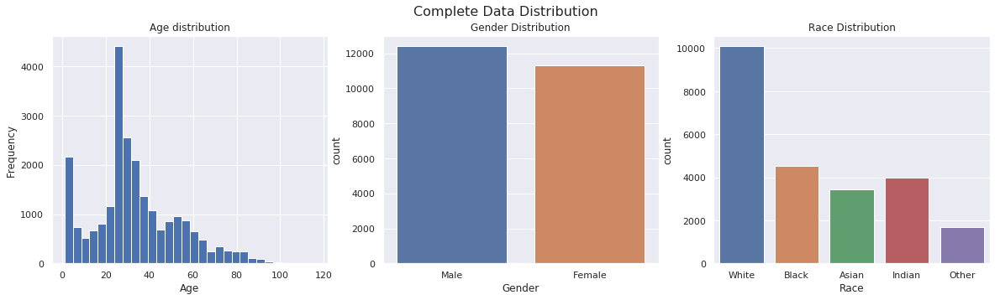

In [0]:
show_datset_distribution(data, 'Complete Data Distribution', save_file_name='figures/full_data_distribution.png')

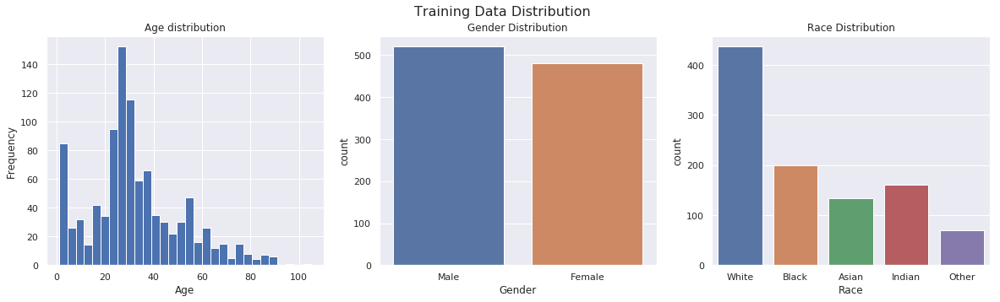

In [0]:
show_datset_distribution(train_data, 'Training Data Distribution')

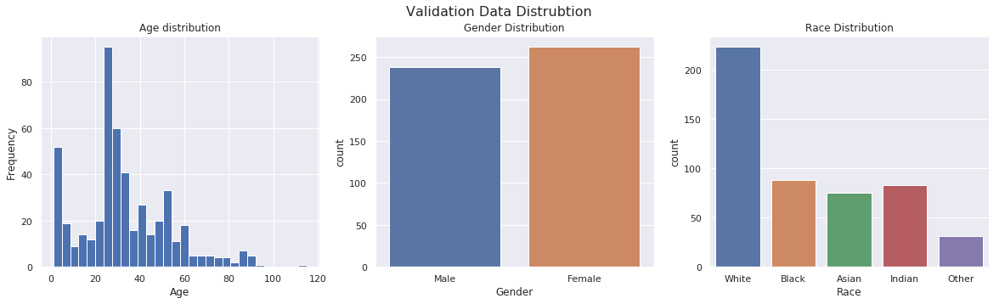

In [0]:
show_datset_distribution(valid_data, 'Validation Data Distrubtion')

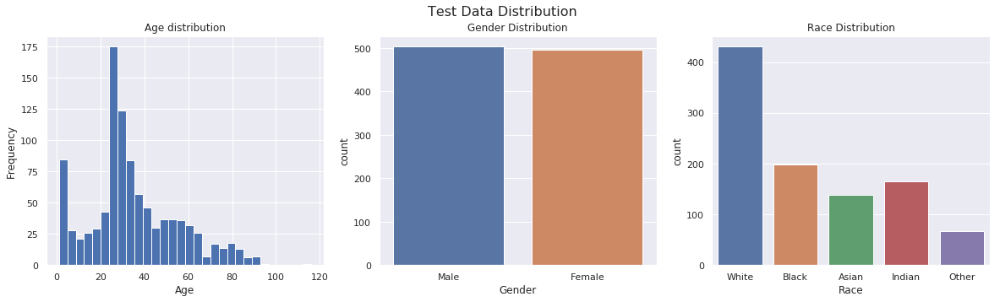

In [0]:
show_datset_distribution(test_data, 'Test Data Distribution')

In [5]:
def show_sample_ukt_images(data=data, show_pred=False):
    sample_faces = data.sample(n=16)
    fig, axes = plt.subplots(4,4, figsize=(20,20))
    for i in range(16):
        sample_face = sample_faces.iloc[i]
        file_name = image_location + sample_face['Name']
        ax = axes[i//4, i%4] # figure out the location
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if not show_pred:
            ax.set_title('Age:' + str(sample_face['Age']))
        else:
            ax.set_title('Age:' + str(sample_face['Age']) + ' Predicted: ' + str(sample_face['predicted_age']))
        ax.imshow(image.load_img(file_name))

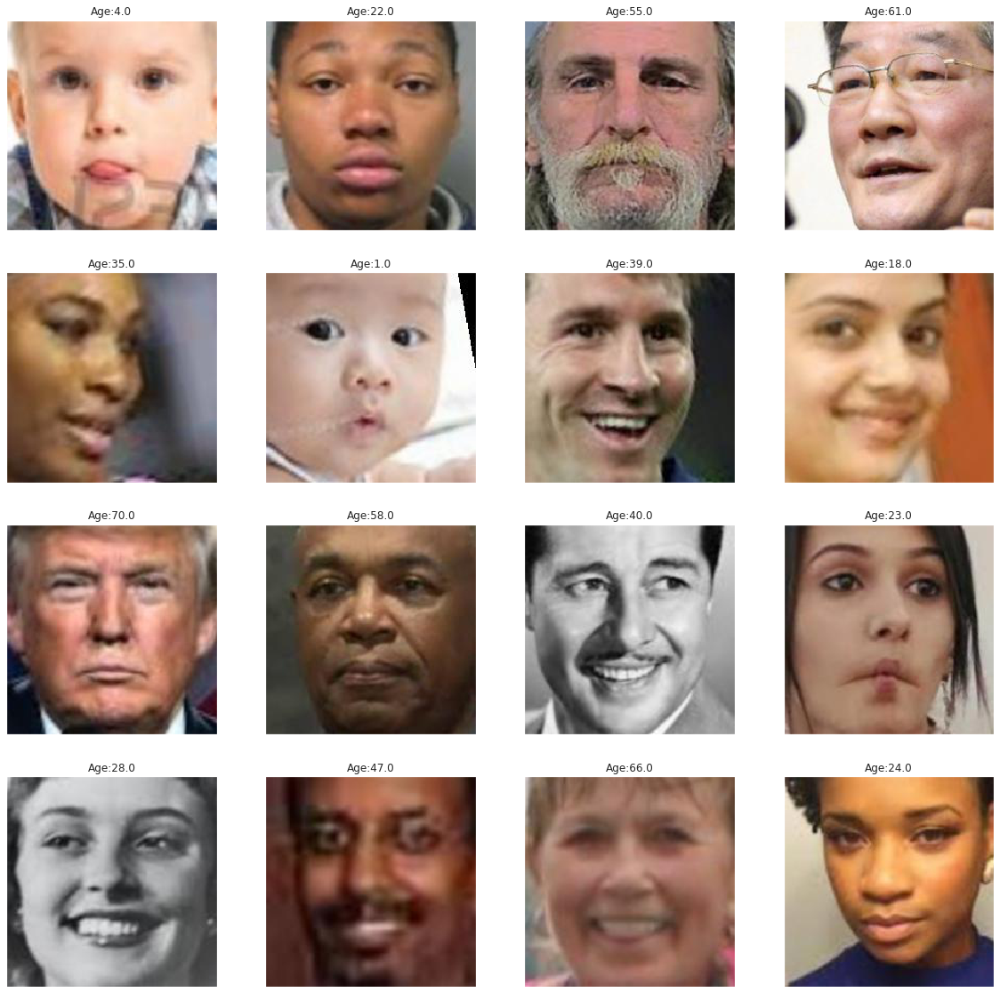

In [0]:
show_sample_ukt_images()

# Feature Extraction

In [0]:
# methods obtained from dog breed classifier project (with modification)
def path_to_tensor(file, target_size):
    img = image.load_img(file, target_size=target_size)
    x = image.img_to_array(img)
    return np.expand_dims(x, axis=0)
  
def paths_to_tensor(files, target_size):
    list_of_tensors = [path_to_tensor(file, target_size) for file in files]
    return np.vstack(list_of_tensors)

def extract_features(files, target_size):
    return feature_extractor.predict(preprocess_input(paths_to_tensor(files, target_size)))

def extract_features_from_tensors(tensors, target_size):
    return feature_extractor.predict(preprocess_input(tensors))


In [0]:
def extract_features_for_dataset(data, file_prefix, target_size, save=True):
    # extract data features for given dataset
    data_features = extract_features(list(map(lambda name: image_location + name, data['Name'])), target_size)
    if save:
        np.save(features_folder + file_prefix + '_data_features', data_features)
    return data_features

In [0]:
train_data_features = extract_features_for_dataset(train_data, 'train', target_size)
train_data_features.shape

In [0]:
valid_data_features = extract_features_for_dataset(valid_data, 'valid', target_size)
valid_data_features.shape

In [0]:
test_data_features = extract_features_for_dataset(test_data, 'test', target_size)
test_data_features.shape

# Load Saved Results

In [6]:
def load_input_features(features_folder):
    train_data_features = np.load(features_folder + 'train_data_features.npy')
    valid_data_features = np.load(features_folder + 'valid_data_features.npy')
    test_data_features = np.load(features_folder + 'test_data_features.npy')
    return train_data_features, valid_data_features, test_data_features

def load_data(processed_folder):
    train_data = pd.read_csv(processed_folder + 'train_data.csv')
    train_targets = train_data['Age']
    valid_data = pd.read_csv(processed_folder + 'valid_data.csv')
    valid_targets = valid_data['Age']
    test_data = pd.read_csv(processed_folder + 'test_data.csv')
    test_targets = test_data['Age']
    return train_data, train_targets, valid_data, valid_targets, test_data, test_targets

train_data_features, valid_data_features, test_data_features = load_input_features(features_folder)
train_data, train_targets, valid_data, valid_targets, test_data, test_targets = load_data(processed_folder)

In [0]:
def load_tensors(processed_folder):
    train_data_tensors = np.load(processed_folder + 'train_data_tensors.npy')
    valid_data_tensors = np.load(processed_folder + 'valid_data_tensors.npy')
    test_data_tensors = np.load(processed_folder + 'test_data_tensors.npy')
    return train_data_tensors, valid_data_tensors, test_data_tensors

In [7]:
def load_augmented_input_features(features_folder):
    train_data_features_augmented = np.load(features_folder + 'train_data_features_augmented.npy')
    valid_data_features_augmented = np.load(features_folder + 'valid_data_features_augmented.npy')
    test_data_features = np.load(features_folder + 'test_data_features.npy')
    return train_data_features_augmented, valid_data_features_augmented, test_data_features

def load_augmented_data(processed_folder):
    train_data_augmented = pd.read_csv(processed_folder + 'train_data_augmented.csv')
    train_targets_augmented = train_data_augmented['Age']
    valid_data_augmented = pd.read_csv(processed_folder + 'valid_data_augmented.csv')
    valid_targets_augmented = valid_data_augmented['Age']
    test_data = pd.read_csv(processed_folder + 'test_data.csv')
    test_targets = test_data['Age']
    return train_data_augmented, train_targets_augmented, valid_data_augmented, valid_targets_augmented, test_data, test_targets

train_data_features_augmented, valid_data_features_augmented, test_data_features = load_augmented_input_features(features_folder)
train_data_augmented, train_targets_augmented, valid_data_augmented, valid_targets_augmented, test_data, test_targets = load_augmented_data(processed_folder)

In [0]:
# only use if you are only dealing with augmented_data, will override train_data_features and ohters. This is required becasue some methods use it as default
train_data_features = train_data_features_augmented
train_targets = train_targets_augmented
valid_data_features = valid_data_features_augmented
valid_targets = valid_targets_augmented

# Custom Metrics

In [8]:
def soft_accuracy_10(y_true, y_pred):
    return K.mean(abs(y_pred - y_true) < 10)
  
def soft_accuracy_5(y_true, y_pred):
    return K.mean(abs(y_pred - y_true) < 5)
  
def tilted_loss(y, f, q=.7):
    # code based on https://sachinruk.github.io/blog/Quantile-Regression/
    e = (y-f)
    return K.mean(K.maximum(q*e, (q-1)*e), axis=-1)

# Model Support Tools

In [11]:
# some methods to avoid repetition
def run_model(model, x=train_data_features, y=train_targets, x_val=valid_data_features, y_val=valid_targets):
    batch_size = 32
    epochs = 100
    model.fit(x, y, validation_data=(x_val, y_val),
          epochs=epochs, batch_size=batch_size, callbacks=[checkpointer, PlotLossesKeras()], verbose=1)
def evaluate_model(model, x=test_data_features, y=test_targets):
    metrics = model.evaluate(x=x, y=y)
    for metric in zip(model.metrics_names, metrics):
        print('{}: {}'.format(metric[0], metric[1]))

# Naive Benchmark

In [0]:
def save_base_tensor(data, file_location):
    # we save the tensor representing the iamge, we shall use this in our naive benchmark
    data_tensors = paths_to_tensor(list(map(lambda name: image_location + '/'+ name, data['Name'])), target_size)
    np.save(file_location, data_tensors)
    return data_tensors

In [0]:
naive_benchmark_folder = processed_folder + '/naive_benchmark/'
train_data_tensors = save_base_tensor(train_data, processed_folder + 'train_data_tensors')
valid_data_tensors = save_base_tensor(valid_data, processed_folder + 'valid_data_tensors')
test_data_tensors = save_base_tensor(test_data,  processed_folder + 'test_data_tensors')
None

In [0]:
# load already saved tensors (if necessary)
train_data_tensors, valid_data_tensors, test_data_tensors = load_tensors(processed_folder)

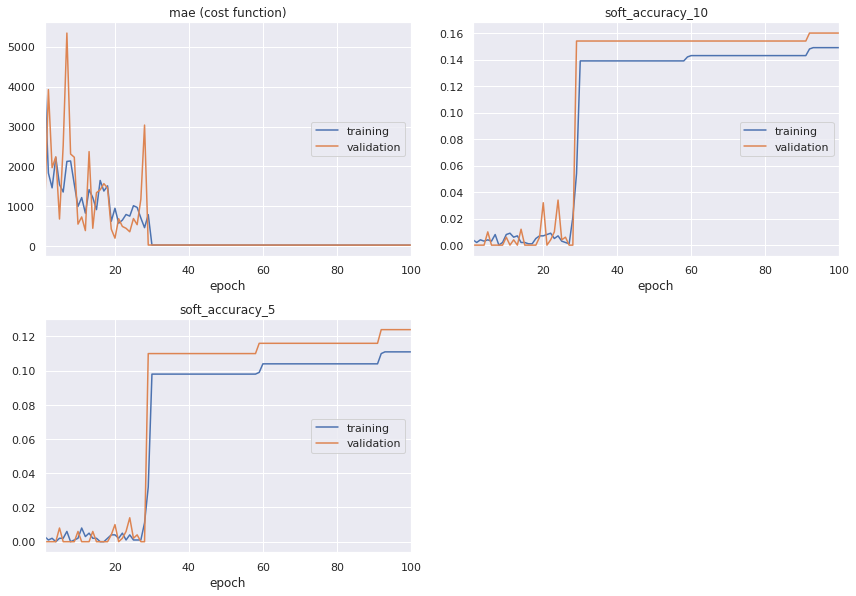

mae (cost function):
training   (min:   30.344, max: 4161.928, cur:   30.344)
validation (min:   30.955, max: 5342.344, cur:   30.955)

soft_accuracy_10:
training   (min:    0.000, max:    0.149, cur:    0.149)
validation (min:    0.000, max:    0.160, cur:    0.160)

soft_accuracy_5:
training   (min:    0.000, max:    0.111, cur:    0.111)
validation (min:    0.000, max:    0.124, cur:    0.124)


In [0]:
def naive_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = naive_model(train_data_tensors.shape[1:])      
model.summary()

checkpointer = ModelCheckpoint(filepath=naive_benchmark_folder + 'weights.best.hdf5', 
                               verbose=1, save_best_only=True)

run_model(model, x=train_data_tensors, x_val=valid_data_tensors)

In [0]:
evaluate_model(model, x=test_data_tensors)

1000/1000 [==============================] - 0s 219us/step
loss: 32.64464935302735
soft_accuracy_10: 0.134
soft_accuracy_5: 0.101


# Model refinement

## Version 1

In [0]:
def cnn_v1_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v1_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v1_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_1 (Dense)              (None, 20)                2007060   
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 21        
Total params: 2,007,081
Trainable params: 2,007,081
Non-trainable params: 0
_________________________________________________________________


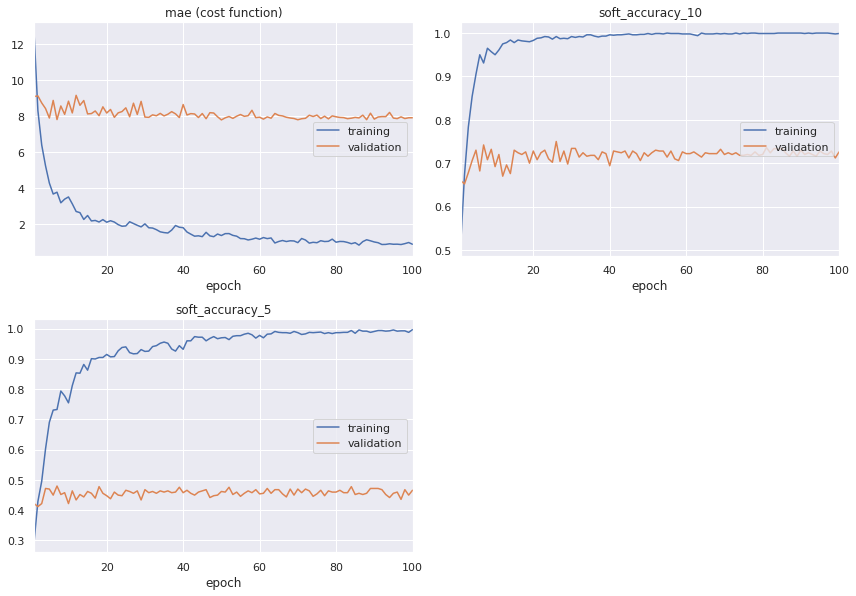

mae (cost function):
training   (min:    0.857, max:   12.593, cur:    0.904)
validation (min:    7.788, max:    9.148, cur:    7.906)

soft_accuracy_10:
training   (min:    0.511, max:    1.000, cur:    0.999)
validation (min:    0.652, max:    0.750, cur:    0.726)

soft_accuracy_5:
training   (min:    0.296, max:    0.997, cur:    0.997)
validation (min:    0.412, max:    0.480, cur:    0.466)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 201us/step
loss: 8.203608184814453
soft_accuracy_10: 0.707
soft_accuracy_5: 0.434


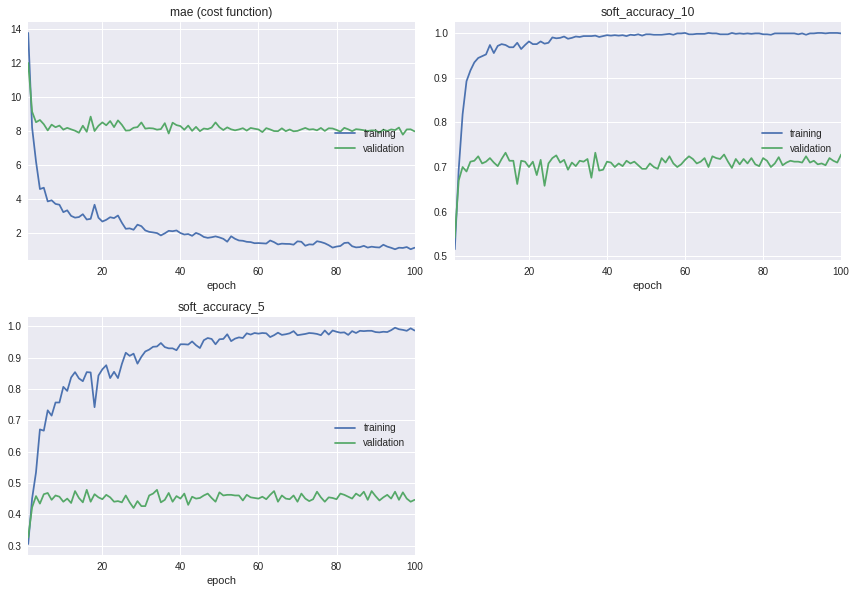

mae (cost function):
training   (min:    1.026, max:   13.769, cur:    1.116)
validation (min:    7.775, max:   12.001, cur:    7.972)

soft_accuracy_10:
training   (min:    0.516, max:    1.000, cur:    0.999)
validation (min:    0.542, max:    0.732, cur:    0.728)

soft_accuracy_5:
training   (min:    0.305, max:    0.996, cur:    0.987)
validation (min:    0.326, max:    0.478, cur:    0.446)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 503us/step
loss: 8.296359596252442
soft_accuracy_10: 0.703
soft_accuracy_5: 0.427


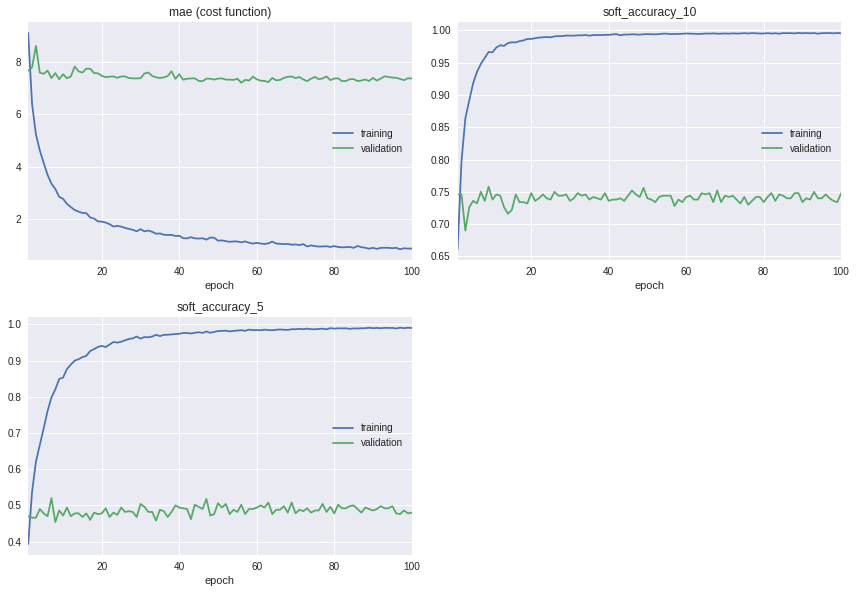

mae (cost function):
training   (min:    0.865, max:    9.097, cur:    0.893)
validation (min:    7.199, max:    8.605, cur:    7.365)

soft_accuracy_10:
training   (min:    0.661, max:    0.996, cur:    0.995)
validation (min:    0.690, max:    0.758, cur:    0.748)

soft_accuracy_5:
training   (min:    0.393, max:    0.991, cur:    0.990)
validation (min:    0.454, max:    0.520, cur:    0.480)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 408us/step
loss: 7.830480251312256
soft_accuracy_10: 0.735
soft_accuracy_5: 0.445


## Version 2

Let us add two batch normalization layers, and two dropout layers, see how they change the results.

In [154]:
def cnn_v2_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dropout(.3))
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v2_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v2_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_16 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_16 (Batc (None, 100352)            401408    
_________________________________________________________________
dropout_16 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_60 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_17 (Batc (None, 20)                80        
_________________________________________________________________
dropout_17 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_61 (Dense)             (None, 1)                 21        
Total para

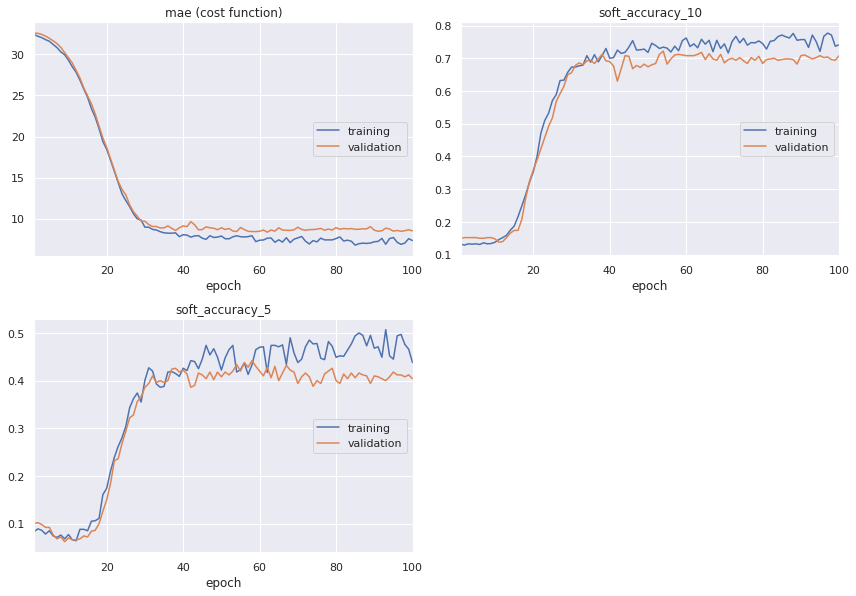

mae (cost function):
training   (min:    6.784, max:   32.418, cur:    7.338)
validation (min:    8.359, max:   32.589, cur:    8.519)

soft_accuracy_10:
training   (min:    0.129, max:    0.777, cur:    0.741)
validation (min:    0.138, max:    0.722, cur:    0.708)

soft_accuracy_5:
training   (min:    0.064, max:    0.507, cur:    0.438)
validation (min:    0.062, max:    0.442, cur:    0.404)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 910us/step
loss: 8.895643241882324
soft_accuracy_10: 0.689
soft_accuracy_5: 0.401


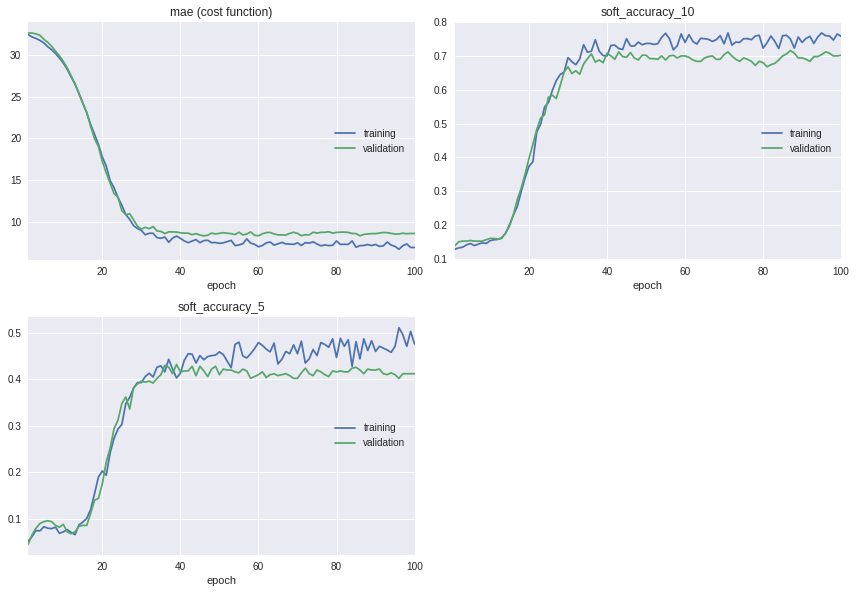

mae (cost function):
training   (min:    6.763, max:   32.389, cur:    6.973)
validation (min:    8.362, max:   32.591, cur:    8.648)

soft_accuracy_10:
training   (min:    0.128, max:    0.768, cur:    0.758)
validation (min:    0.138, max:    0.716, cur:    0.702)

soft_accuracy_5:
training   (min:    0.052, max:    0.511, cur:    0.476)
validation (min:    0.046, max:    0.432, cur:    0.412)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 9.044023208618164
soft_accuracy_10: 0.682
soft_accuracy_5: 0.39


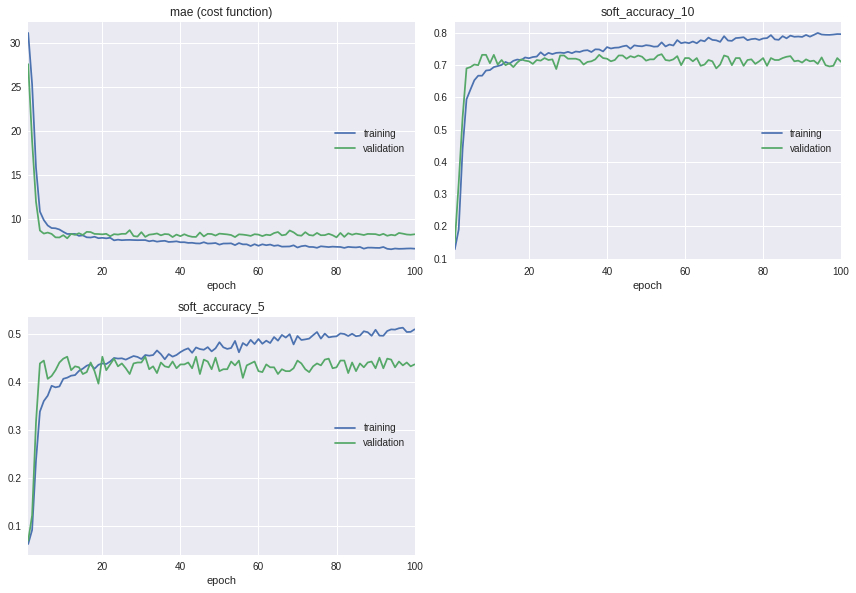

mae (cost function):
training   (min:    6.588, max:   31.150, cur:    6.652)
validation (min:    7.830, max:   27.598, cur:    8.287)

soft_accuracy_10:
training   (min:    0.129, max:    0.800, cur:    0.796)
validation (min:    0.150, max:    0.734, cur:    0.710)

soft_accuracy_5:
training   (min:    0.063, max:    0.512, cur:    0.509)
validation (min:    0.070, max:    0.452, cur:    0.436)


In [155]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [156]:
evaluate_model(model)

1000/1000 [==============================] - 0s 435us/step
loss: 8.83940773010254
soft_accuracy_10: 0.694
soft_accuracy_5: 0.417


## Version 3

Let us increase the drop out percentage of our first dropout layer and observe the effect.

In [0]:
def cnn_v3_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v3_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v3_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_10 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_4 (Batch (None, 100352)            401408    
_________________________________________________________________
dropout_4 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_48 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_5 (Batch (None, 20)                80        
_________________________________________________________________
dropout_5 (Dropout)          (None, 20)                0         
_________________________________________________________________
dense_49 (Dense)             (None, 1)                 21        
Total para

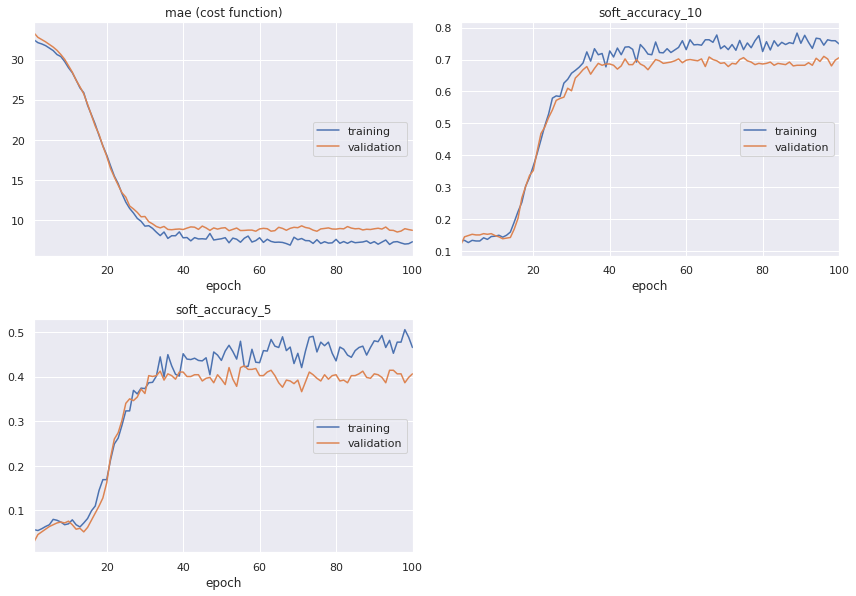

mae (cost function):
training   (min:    6.938, max:   32.431, cur:    7.357)
validation (min:    8.568, max:   33.284, cur:    8.778)

soft_accuracy_10:
training   (min:    0.126, max:    0.783, cur:    0.749)
validation (min:    0.118, max:    0.710, cur:    0.706)

soft_accuracy_5:
training   (min:    0.055, max:    0.505, cur:    0.465)
validation (min:    0.030, max:    0.424, cur:    0.406)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 925us/step
loss: 8.903860633850098
soft_accuracy_10: 0.688
soft_accuracy_5: 0.418


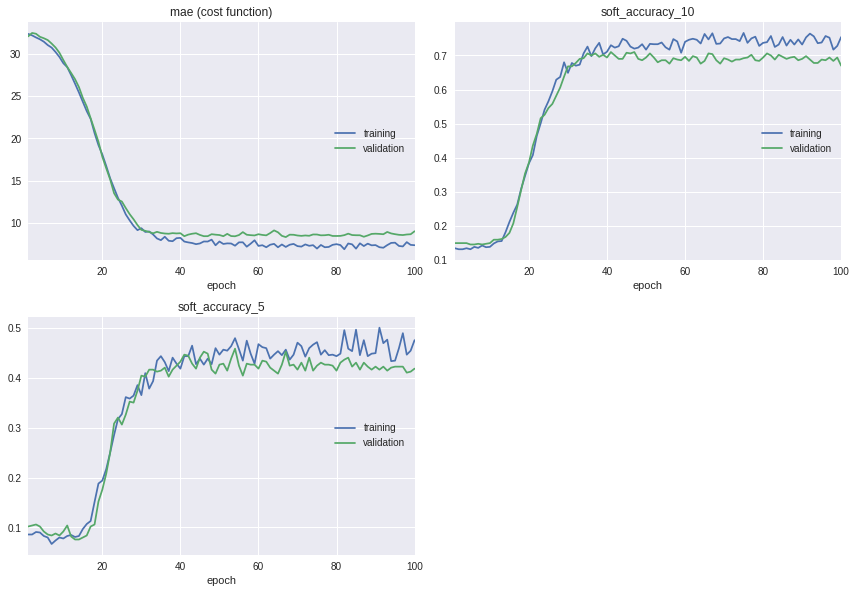

mae (cost function):
training   (min:    6.927, max:   32.332, cur:    7.405)
validation (min:    8.362, max:   32.446, cur:    9.047)

soft_accuracy_10:
training   (min:    0.132, max:    0.766, cur:    0.754)
validation (min:    0.146, max:    0.710, cur:    0.670)

soft_accuracy_5:
training   (min:    0.067, max:    0.500, cur:    0.475)
validation (min:    0.076, max:    0.458, cur:    0.418)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 9.289843383789062
soft_accuracy_10: 0.671
soft_accuracy_5: 0.413


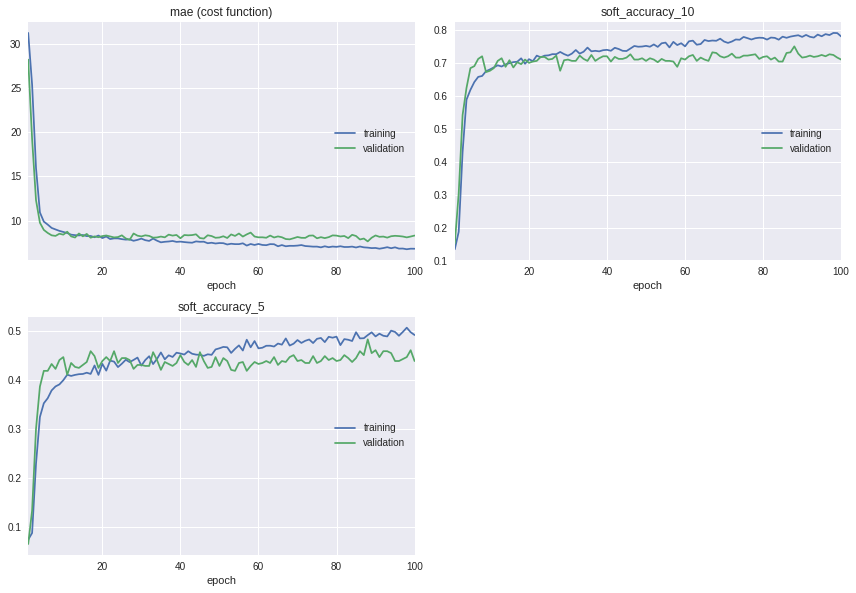

mae (cost function):
training   (min:    6.767, max:   31.199, cur:    6.824)
validation (min:    7.655, max:   28.182, cur:    8.314)

soft_accuracy_10:
training   (min:    0.134, max:    0.791, cur:    0.780)
validation (min:    0.152, max:    0.750, cur:    0.710)

soft_accuracy_5:
training   (min:    0.075, max:    0.506, cur:    0.491)
validation (min:    0.066, max:    0.482, cur:    0.438)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [141]:
evaluate_model(model)

1000/1000 [==============================] - 0s 449us/step
loss: 8.606339584350586
soft_accuracy_10: 0.697
soft_accuracy_5: 0.438


## Version 4

In [151]:
def cnn_v4_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(1))
    adam = optimizers.Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
    model.compile(loss='mae', optimizer=adam, metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v4_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v4_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_15 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_14 (Batc (None, 100352)            401408    
_________________________________________________________________
dropout_14 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_58 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_15 (Batc (None, 20)                80        
_________________________________________________________________
dropout_15 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_59 (Dense)             (None, 1)                 21        
Total para

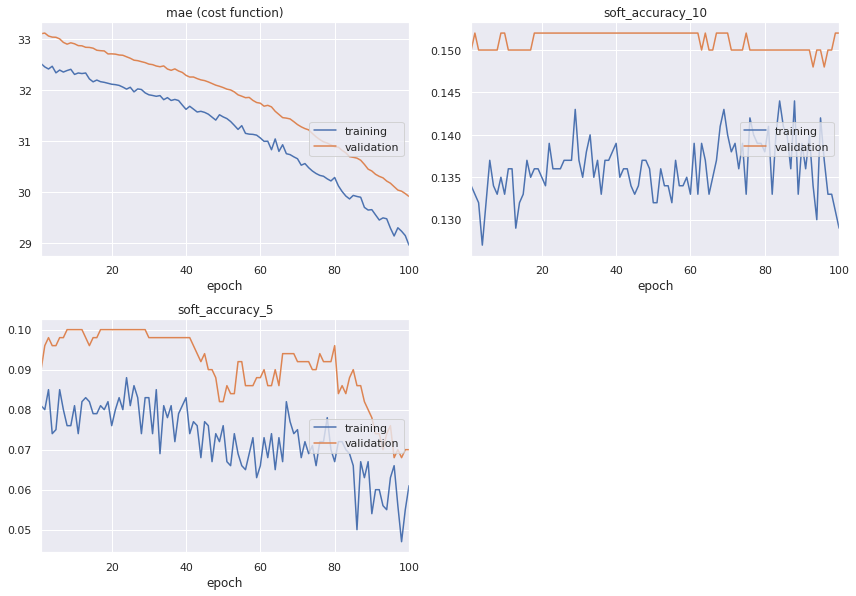

mae (cost function):
training   (min:   28.959, max:   32.520, cur:   28.959)
validation (min:   29.914, max:   33.119, cur:   29.914)

soft_accuracy_10:
training   (min:    0.127, max:    0.144, cur:    0.129)
validation (min:    0.148, max:    0.152, cur:    0.152)

soft_accuracy_5:
training   (min:    0.047, max:    0.088, cur:    0.061)
validation (min:    0.068, max:    0.100, cur:    0.070)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 31.371047302246094
soft_accuracy_10: 0.129
soft_accuracy_5: 0.055


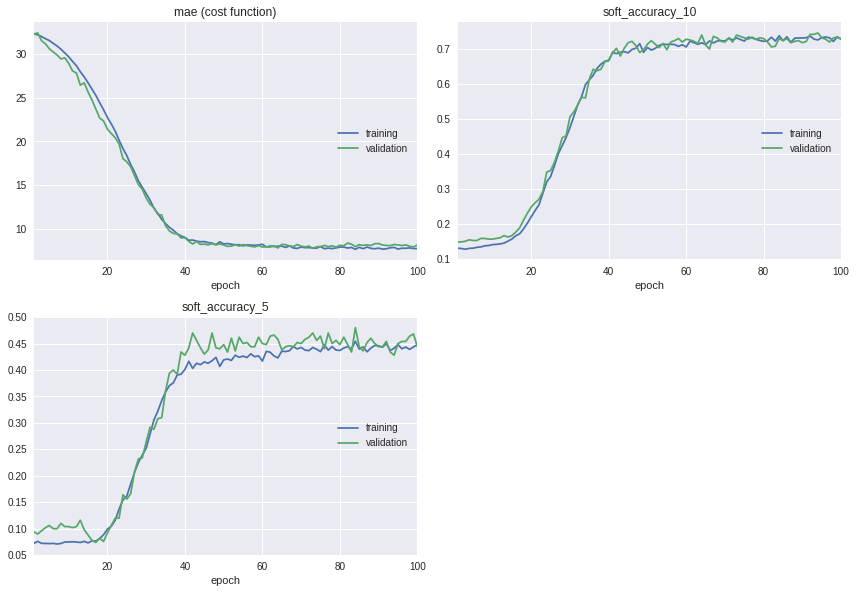

mae (cost function):
training   (min:    7.642, max:   32.360, cur:    7.716)
validation (min:    7.737, max:   32.447, cur:    8.126)

soft_accuracy_10:
training   (min:    0.127, max:    0.738, cur:    0.729)
validation (min:    0.148, max:    0.746, cur:    0.728)

soft_accuracy_5:
training   (min:    0.071, max:    0.454, cur:    0.448)
validation (min:    0.074, max:    0.480, cur:    0.444)


In [152]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [153]:
evaluate_model(model)

1000/1000 [==============================] - 0s 431us/step
loss: 8.418618827819824
soft_accuracy_10: 0.7
soft_accuracy_5: 0.465


## Version 5

In [157]:
def cnn_v5_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(1))
    adam = optimizers.Adam(lr=0.001, decay=1e-5)
    model.compile(loss='mae', optimizer=adam, metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v5_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v5_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_17 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_18 (Batc (None, 100352)            401408    
_________________________________________________________________
dropout_18 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_62 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_19 (Batc (None, 20)                80        
_________________________________________________________________
dropout_19 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_63 (Dense)             (None, 1)                 21        
Total para

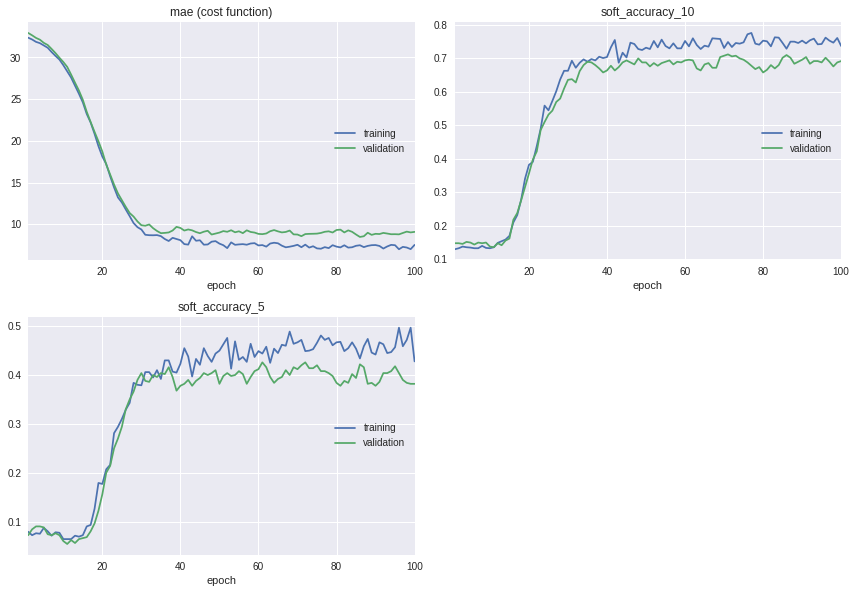

mae (cost function):
training   (min:    7.002, max:   32.372, cur:    7.521)
validation (min:    8.476, max:   32.941, cur:    9.086)

soft_accuracy_10:
training   (min:    0.130, max:    0.776, cur:    0.737)
validation (min:    0.136, max:    0.712, cur:    0.692)

soft_accuracy_5:
training   (min:    0.064, max:    0.497, cur:    0.428)
validation (min:    0.054, max:    0.426, cur:    0.382)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 9.22922038269043
soft_accuracy_10: 0.677
soft_accuracy_5: 0.412


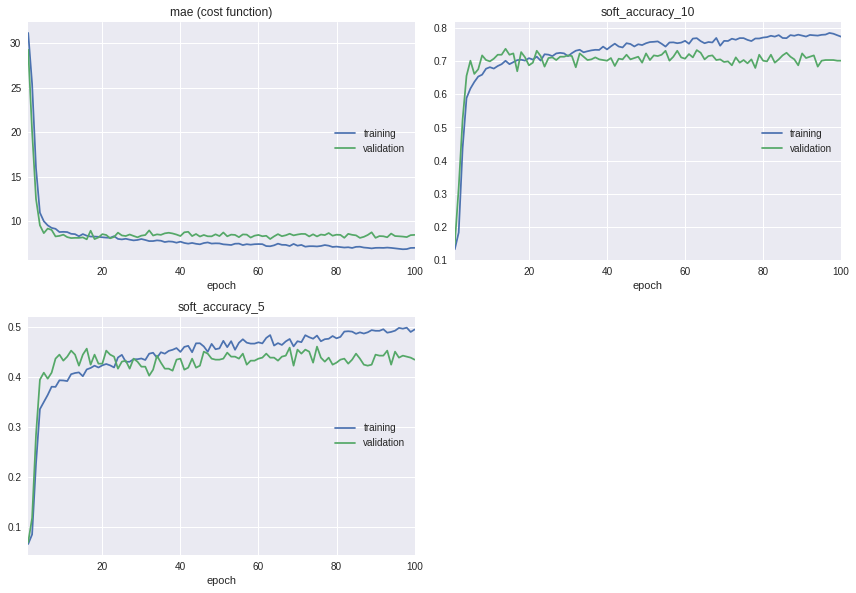

mae (cost function):
training   (min:    6.802, max:   31.182, cur:    6.960)
validation (min:    7.923, max:   29.288, cur:    8.420)

soft_accuracy_10:
training   (min:    0.132, max:    0.786, cur:    0.775)
validation (min:    0.148, max:    0.738, cur:    0.702)

soft_accuracy_5:
training   (min:    0.066, max:    0.498, cur:    0.494)
validation (min:    0.070, max:    0.460, cur:    0.434)


In [158]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [159]:
evaluate_model(model)

1000/1000 [==============================] - 0s 479us/step
loss: 8.792866340637207
soft_accuracy_10: 0.689
soft_accuracy_5: 0.433


## Version 6

In [160]:
def cnn_v6_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(.5))
    model.add(Dense(1))
    adam = optimizers.Adam(lr=0.001, decay=1e-5)
    model.compile(loss=tilted_loss, optimizer=adam, metrics=['mae', soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v6_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v6_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_18 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_20 (Batc (None, 100352)            401408    
_________________________________________________________________
dropout_20 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_64 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_21 (Batc (None, 20)                80        
_________________________________________________________________
dropout_21 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_65 (Dense)             (None, 1)                 21        
Total para

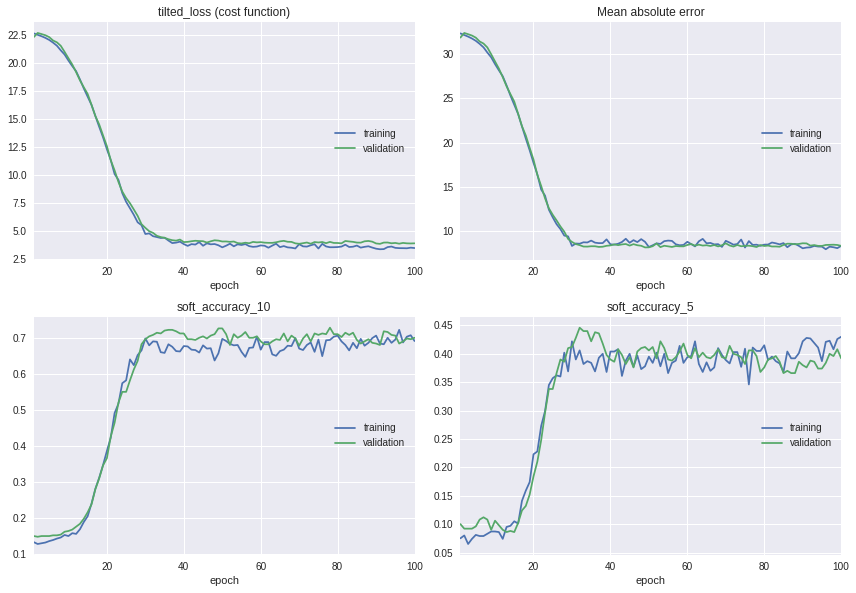

tilted_loss (cost function):
training   (min:    3.369, max:   22.611, cur:    3.476)
validation (min:    3.849, max:   22.651, cur:    3.897)

Mean absolute error:
training   (min:    7.978, max:   32.307, cur:    8.357)
validation (min:    8.186, max:   32.359, cur:    8.360)

soft_accuracy_10:
training   (min:    0.128, max:    0.722, cur:    0.691)
validation (min:    0.148, max:    0.728, cur:    0.700)

soft_accuracy_5:
training   (min:    0.065, max:    0.430, cur:    0.430)
validation (min:    0.086, max:    0.446, cur:    0.392)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 4.187641273498535
mean_absolute_error: 8.929462379455567
soft_accuracy_10: 0.665
soft_accuracy_5: 0.351


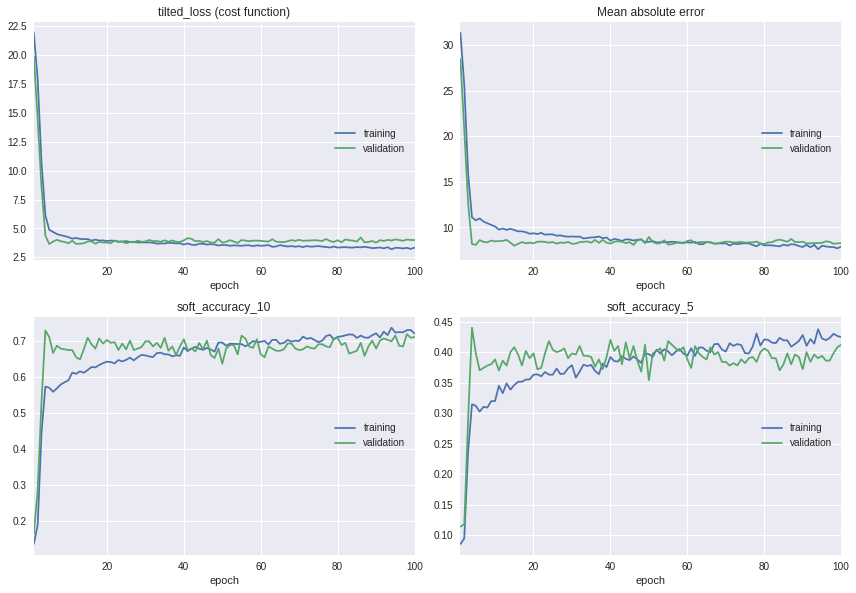

tilted_loss (cost function):
training   (min:    3.198, max:   21.935, cur:    3.335)
validation (min:    3.652, max:   19.901, cur:    3.998)

Mean absolute error:
training   (min:    7.608, max:   31.341, cur:    7.889)
validation (min:    7.997, max:   28.451, cur:    8.269)

soft_accuracy_10:
training   (min:    0.137, max:    0.736, cur:    0.720)
validation (min:    0.166, max:    0.728, cur:    0.710)

soft_accuracy_5:
training   (min:    0.086, max:    0.437, cur:    0.424)
validation (min:    0.114, max:    0.440, cur:    0.412)


In [161]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [162]:
evaluate_model(model)

1000/1000 [==============================] - 0s 472us/step
loss: 4.24947371673584
mean_absolute_error: 8.76212361907959
soft_accuracy_10: 0.669
soft_accuracy_5: 0.369


## Version 7


In [163]:
def cnn_v7_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(BatchNormalization())
    model.add(Dense(20, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v7_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v7_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_19 (Flatten)         (None, 100352)            0         
_________________________________________________________________
batch_normalization_22 (Batc (None, 100352)            401408    
_________________________________________________________________
dense_66 (Dense)             (None, 20)                2007060   
_________________________________________________________________
batch_normalization_23 (Batc (None, 20)                80        
_________________________________________________________________
dense_67 (Dense)             (None, 1)                 21        
Total params: 2,408,569
Trainable params: 2,207,825
Non-trainable params: 200,744
_________________________________________________________________


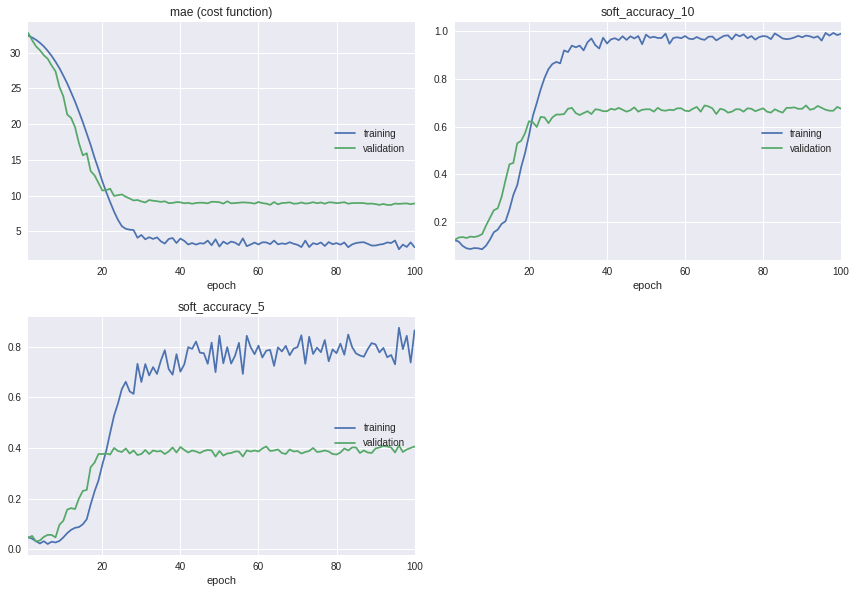

mae (cost function):
training   (min:    2.505, max:   32.366, cur:    2.787)
validation (min:    8.701, max:   32.744, cur:    8.904)

soft_accuracy_10:
training   (min:    0.087, max:    0.991, cur:    0.988)
validation (min:    0.126, max:    0.688, cur:    0.674)

soft_accuracy_5:
training   (min:    0.020, max:    0.876, cur:    0.865)
validation (min:    0.030, max:    0.410, cur:    0.406)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 9.058921913146973
soft_accuracy_10: 0.673
soft_accuracy_5: 0.413


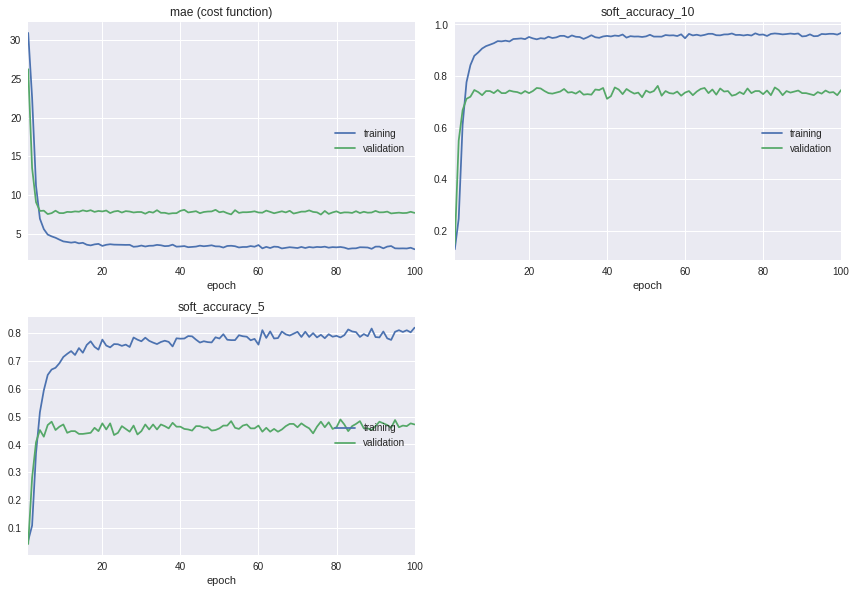

mae (cost function):
training   (min:    3.075, max:   30.862, cur:    3.075)
validation (min:    7.533, max:   26.196, cur:    7.748)

soft_accuracy_10:
training   (min:    0.129, max:    0.967, cur:    0.967)
validation (min:    0.150, max:    0.762, cur:    0.746)

soft_accuracy_5:
training   (min:    0.054, max:    0.820, cur:    0.820)
validation (min:    0.042, max:    0.490, cur:    0.472)


In [164]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [165]:
evaluate_model(model)

1000/1000 [==============================] - 0s 452us/step
loss: 8.122131912231445
soft_accuracy_10: 0.714
soft_accuracy_5: 0.444


## Version 8


In [166]:
def cnn_v8_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(20, activation='relu'))
    model.add(Dropout(.5))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v8_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v8_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_20 (Flatten)         (None, 100352)            0         
_________________________________________________________________
dense_68 (Dense)             (None, 20)                2007060   
_________________________________________________________________
dropout_22 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_69 (Dense)             (None, 1)                 21        
Total params: 2,007,081
Trainable params: 2,007,081
Non-trainable params: 0
_________________________________________________________________


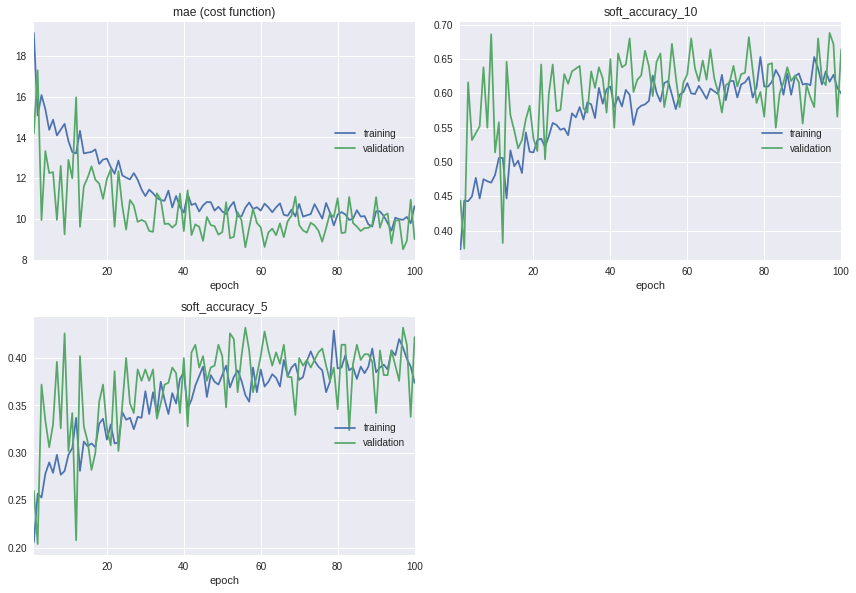

mae (cost function):
training   (min:    9.430, max:   19.126, cur:   10.632)
validation (min:    8.518, max:   17.289, cur:    9.015)

soft_accuracy_10:
training   (min:    0.373, max:    0.653, cur:    0.600)
validation (min:    0.374, max:    0.688, cur:    0.664)

soft_accuracy_5:
training   (min:    0.206, max:    0.429, cur:    0.374)
validation (min:    0.204, max:    0.432, cur:    0.422)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 2s 2ms/step
loss: 9.058921913146973
soft_accuracy_10: 0.673
soft_accuracy_5: 0.413


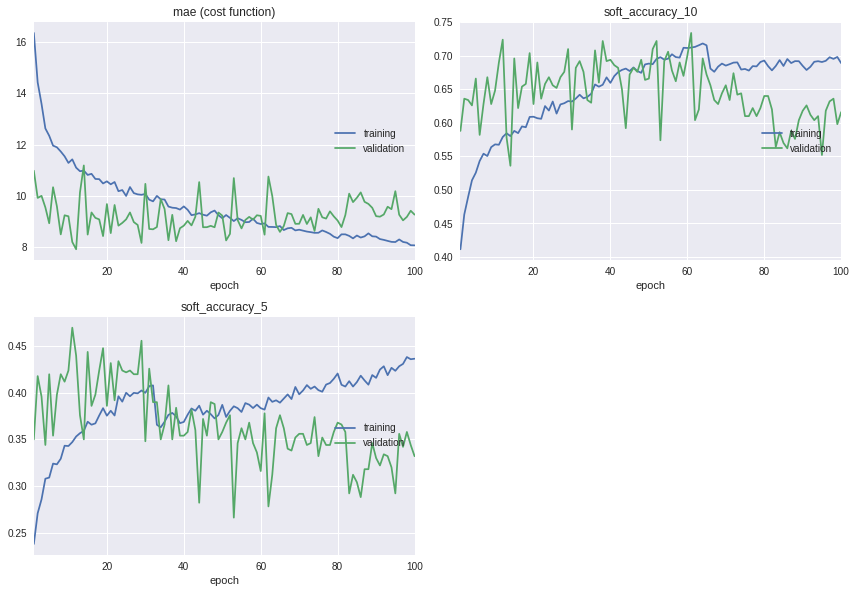

mae (cost function):
training   (min:    8.072, max:   16.357, cur:    8.072)
validation (min:    7.919, max:   11.189, cur:    9.270)

soft_accuracy_10:
training   (min:    0.412, max:    0.718, cur:    0.689)
validation (min:    0.536, max:    0.734, cur:    0.616)

soft_accuracy_5:
training   (min:    0.238, max:    0.438, cur:    0.437)
validation (min:    0.266, max:    0.470, cur:    0.332)


In [167]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [168]:
evaluate_model(model)

1000/1000 [==============================] - 0s 378us/step
loss: 9.313699989318847
soft_accuracy_10: 0.616
soft_accuracy_5: 0.353


## Version 9


In [169]:
def cnn_v9_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dropout(.3))
    model.add(Dense(20, activation='relu'))
    model.add(Dropout(.5))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v9_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v9_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_21 (Flatten)         (None, 100352)            0         
_________________________________________________________________
dropout_23 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_70 (Dense)             (None, 20)                2007060   
_________________________________________________________________
dropout_24 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_71 (Dense)             (None, 1)                 21        
Total params: 2,007,081
Trainable params: 2,007,081
Non-trainable params: 0
_________________________________________________________________


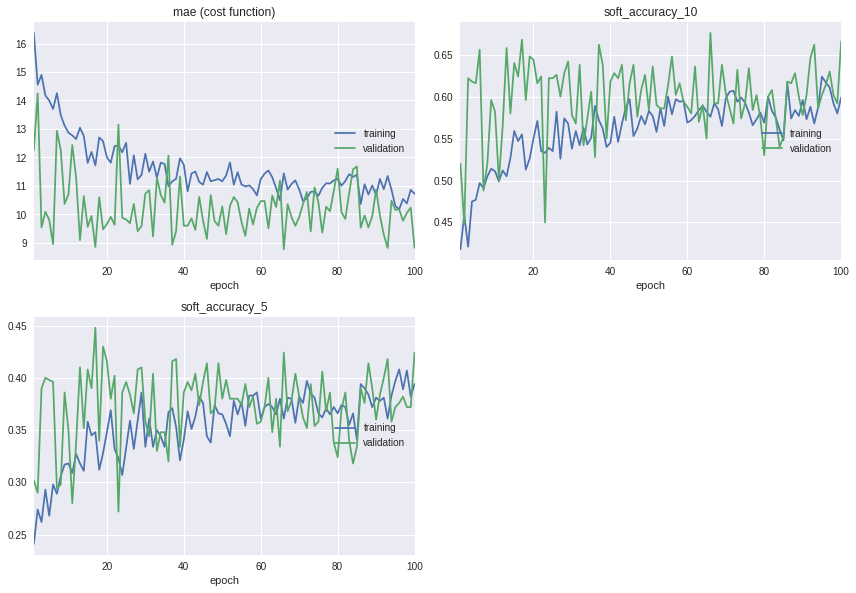

mae (cost function):
training   (min:   10.180, max:   16.371, cur:   10.725)
validation (min:    8.779, max:   14.248, cur:    8.830)

soft_accuracy_10:
training   (min:    0.418, max:    0.624, cur:    0.599)
validation (min:    0.448, max:    0.676, cur:    0.666)

soft_accuracy_5:
training   (min:    0.241, max:    0.408, cur:    0.394)
validation (min:    0.272, max:    0.448, cur:    0.424)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 417us/step
loss: 9.047543548583985
soft_accuracy_10: 0.67
soft_accuracy_5: 0.42


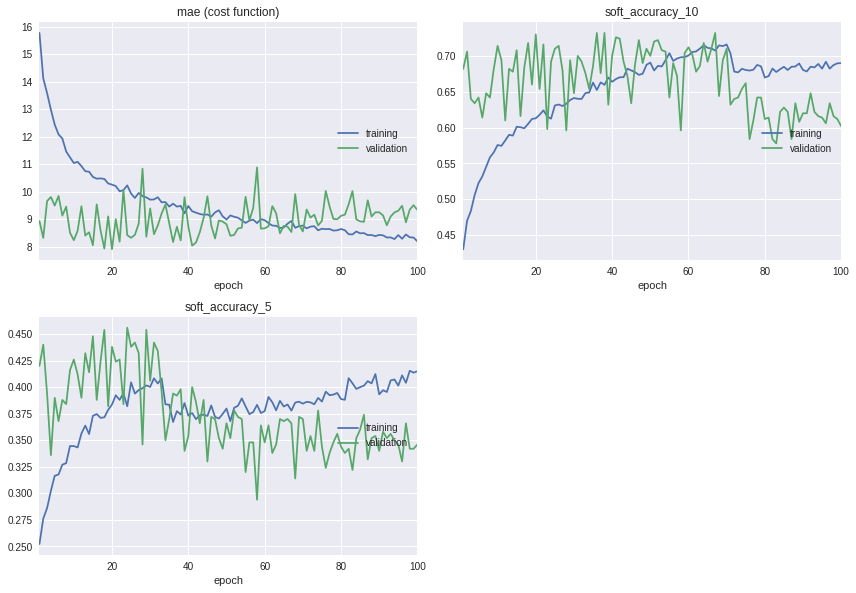

mae (cost function):
training   (min:    8.195, max:   15.772, cur:    8.195)
validation (min:    7.909, max:   10.885, cur:    9.340)

soft_accuracy_10:
training   (min:    0.430, max:    0.716, cur:    0.690)
validation (min:    0.578, max:    0.732, cur:    0.602)

soft_accuracy_5:
training   (min:    0.252, max:    0.415, cur:    0.415)
validation (min:    0.294, max:    0.456, cur:    0.346)


In [170]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [171]:
evaluate_model(model)

1000/1000 [==============================] - 0s 447us/step
loss: 9.590321609497071
soft_accuracy_10: 0.612
soft_accuracy_5: 0.352


## Version 10

In [101]:
def cnn_v10_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v10_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v10_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_2 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_7 (Dense)              (None, 50)                5017650   
_________________________________________________________________
dense_8 (Dense)              (None, 50)                2550      
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 51        
Total params: 5,020,251
Trainable params: 5,020,251
Non-trainable params: 0
_________________________________________________________________


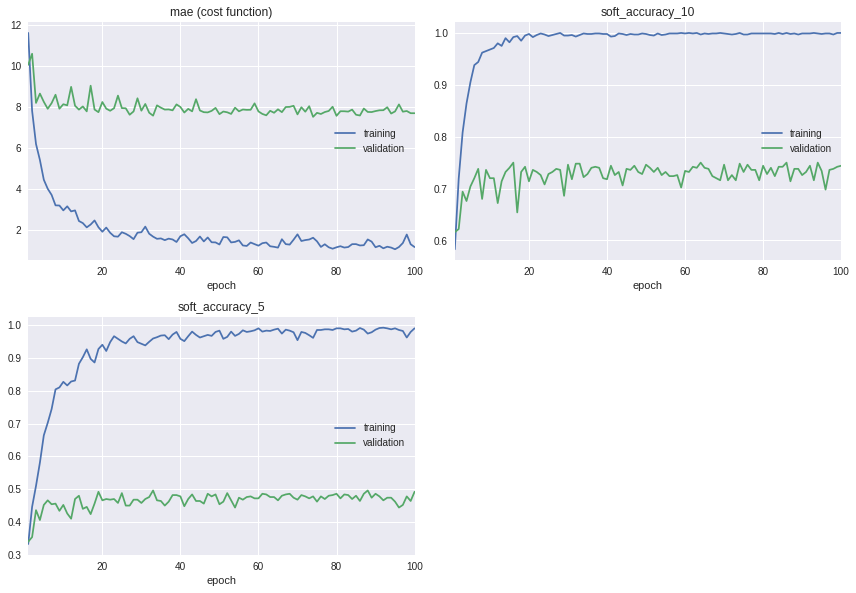

mae (cost function):
training   (min:    1.041, max:   11.621, cur:    1.149)
validation (min:    7.516, max:   10.604, cur:    7.695)

soft_accuracy_10:
training   (min:    0.583, max:    1.000, cur:    1.000)
validation (min:    0.616, max:    0.750, cur:    0.744)

soft_accuracy_5:
training   (min:    0.333, max:    0.992, cur:    0.990)
validation (min:    0.340, max:    0.496, cur:    0.492)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 603us/step
loss: 7.986796051025391
soft_accuracy_10: 0.716
soft_accuracy_5: 0.47


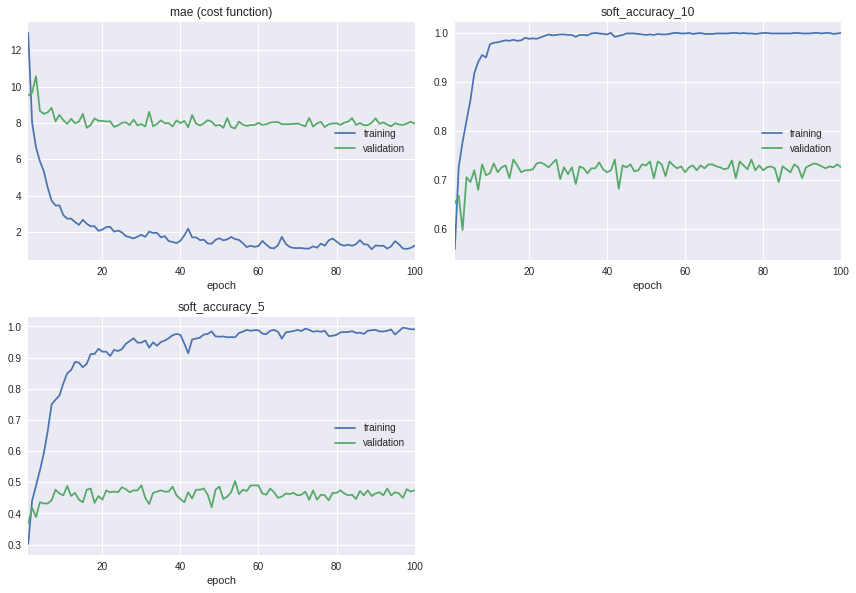

mae (cost function):
training   (min:    1.052, max:   12.949, cur:    1.248)
validation (min:    7.702, max:   10.569, cur:    7.969)

soft_accuracy_10:
training   (min:    0.559, max:    1.000, cur:    1.000)
validation (min:    0.598, max:    0.742, cur:    0.726)

soft_accuracy_5:
training   (min:    0.302, max:    0.996, cur:    0.991)
validation (min:    0.368, max:    0.504, cur:    0.474)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 694us/step
loss: 8.327852874755859
soft_accuracy_10: 0.71
soft_accuracy_5: 0.44


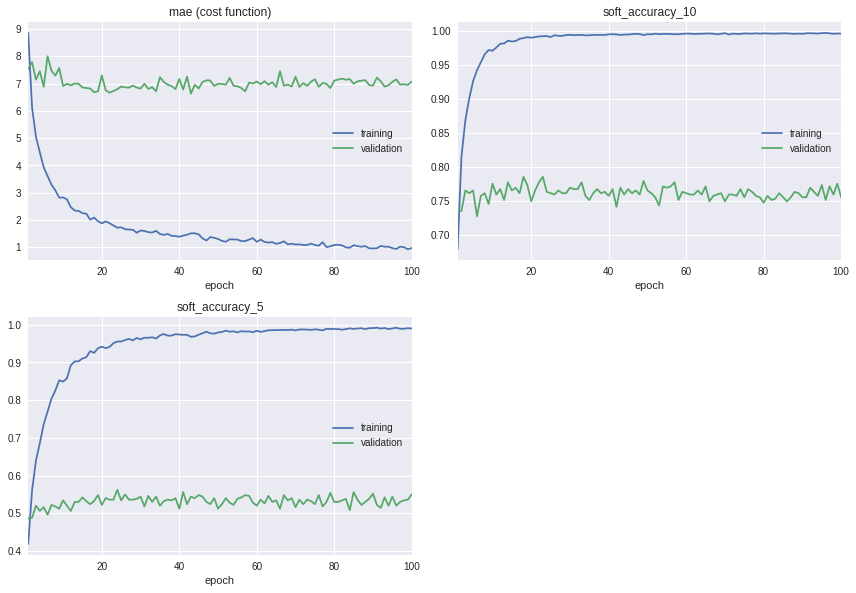

mae (cost function):
training   (min:    0.928, max:    8.858, cur:    0.973)
validation (min:    6.634, max:    8.002, cur:    7.074)

soft_accuracy_10:
training   (min:    0.680, max:    0.997, cur:    0.996)
validation (min:    0.728, max:    0.786, cur:    0.756)

soft_accuracy_5:
training   (min:    0.418, max:    0.992, cur:    0.990)
validation (min:    0.486, max:    0.562, cur:    0.550)


In [104]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [105]:
evaluate_model(model)

1000/1000 [==============================] - 0s 402us/step
loss: 7.9073189239501955
soft_accuracy_10: 0.72
soft_accuracy_5: 0.486


## Verison 11

In [106]:
def cnn_v11_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v11_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v11_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_3 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_10 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_11 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_12 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 51        
Total params: 5,022,801
Trainable params: 5,022,801
Non-trainable params: 0
_________________________________________________________________


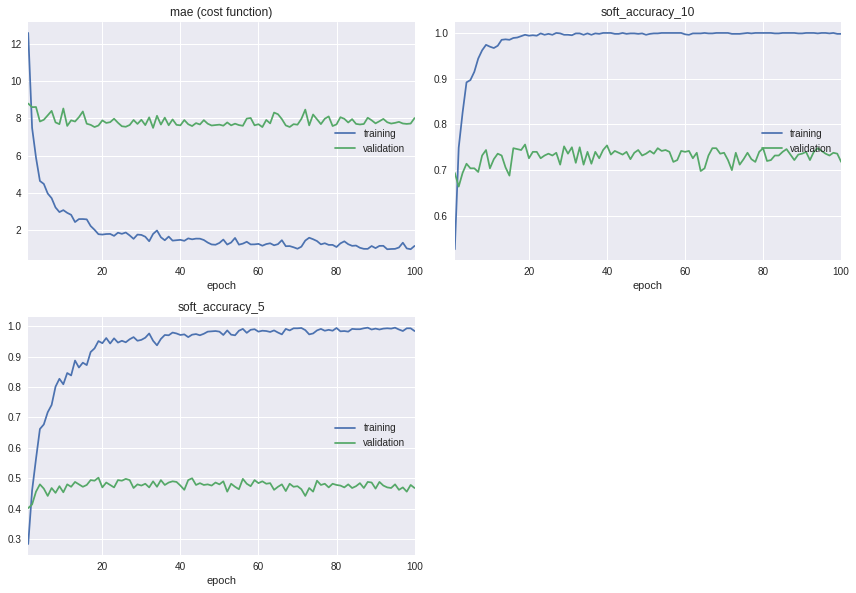

mae (cost function):
training   (min:    0.979, max:   12.583, cur:    1.157)
validation (min:    7.490, max:    8.796, cur:    8.017)

soft_accuracy_10:
training   (min:    0.527, max:    1.000, cur:    0.998)
validation (min:    0.664, max:    0.756, cur:    0.718)

soft_accuracy_5:
training   (min:    0.284, max:    0.995, cur:    0.984)
validation (min:    0.402, max:    0.502, cur:    0.468)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 617us/step
loss: 8.249612228393556
soft_accuracy_10: 0.714
soft_accuracy_5: 0.454


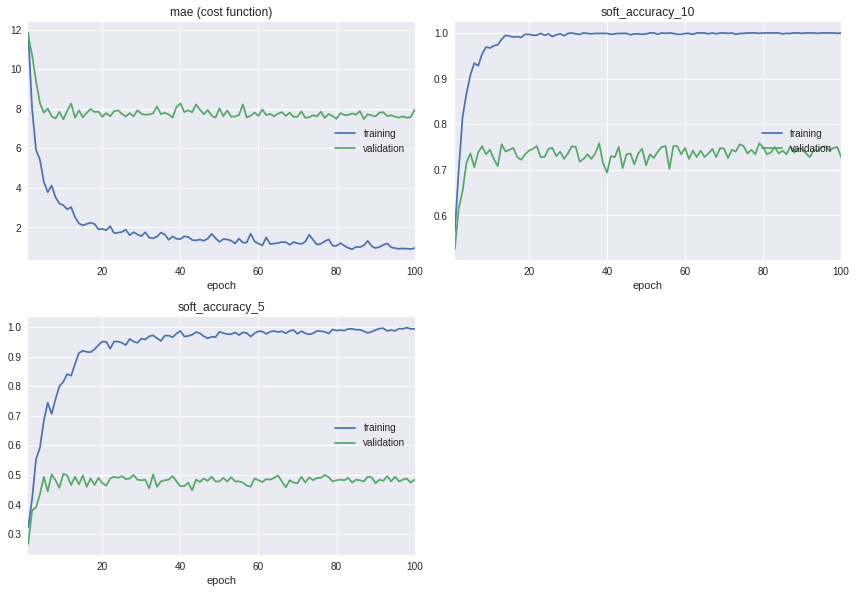

mae (cost function):
training   (min:    0.897, max:   11.837, cur:    0.952)
validation (min:    7.467, max:   11.716, cur:    7.950)

soft_accuracy_10:
training   (min:    0.564, max:    1.000, cur:    1.000)
validation (min:    0.526, max:    0.758, cur:    0.728)

soft_accuracy_5:
training   (min:    0.323, max:    0.999, cur:    0.995)
validation (min:    0.266, max:    0.504, cur:    0.484)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 620us/step
loss: 8.202261833190917
soft_accuracy_10: 0.713
soft_accuracy_5: 0.464


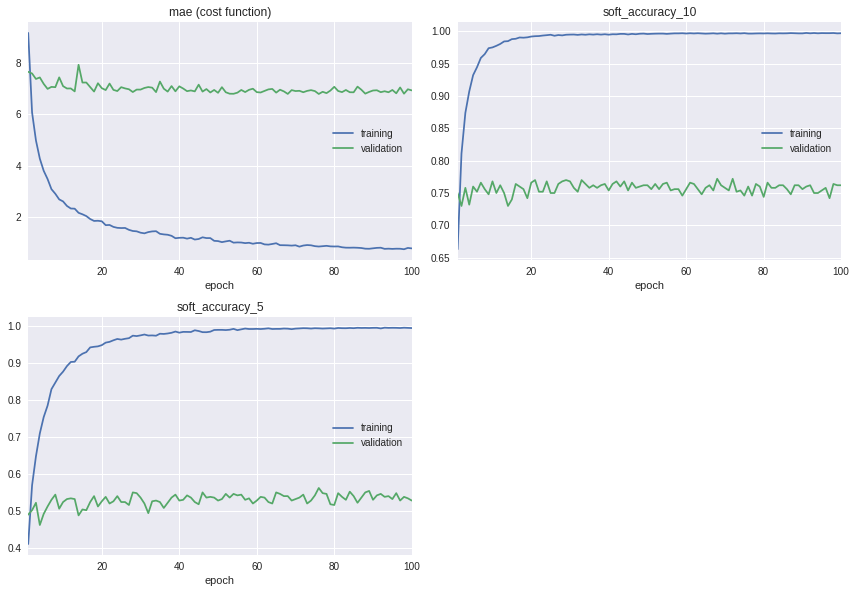

mae (cost function):
training   (min:    0.745, max:    9.171, cur:    0.779)
validation (min:    6.794, max:    7.931, cur:    6.933)

soft_accuracy_10:
training   (min:    0.663, max:    0.997, cur:    0.997)
validation (min:    0.730, max:    0.772, cur:    0.762)

soft_accuracy_5:
training   (min:    0.411, max:    0.995, cur:    0.994)
validation (min:    0.462, max:    0.562, cur:    0.528)


In [107]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [108]:
evaluate_model(model)

1000/1000 [==============================] - 0s 390us/step
loss: 7.360513229370117
soft_accuracy_10: 0.72
soft_accuracy_5: 0.504


## Verison 12

In [109]:
def cnn_v12_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dropout(.5))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v12_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v12_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_4 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_14 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_15 (Dense)             (None, 100)               5100      
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 101       
Total params: 5,022,851
Trainable params: 5,022,851
Non-trainable params: 0
_________________________________________________________________


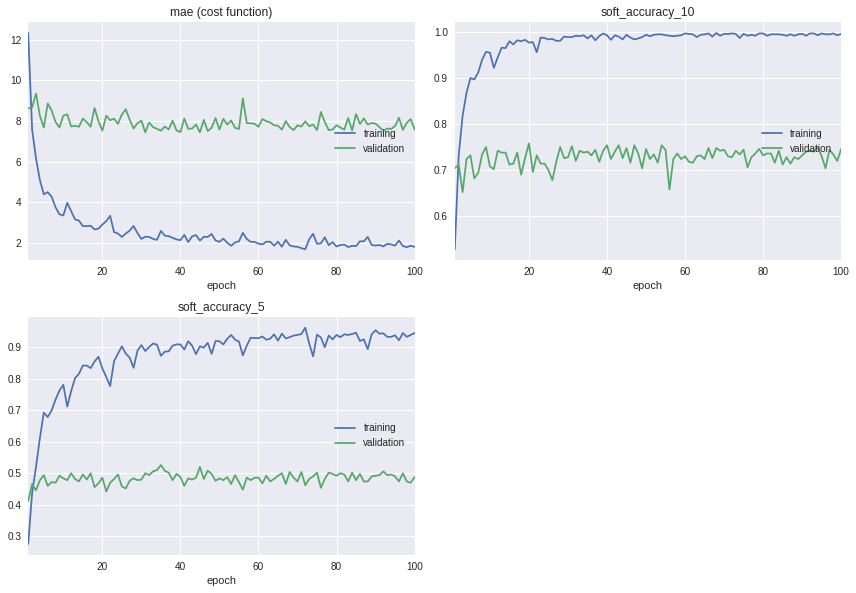

mae (cost function):
training   (min:    1.682, max:   12.328, cur:    1.803)
validation (min:    7.434, max:    9.345, cur:    7.581)

soft_accuracy_10:
training   (min:    0.528, max:    0.998, cur:    0.996)
validation (min:    0.652, max:    0.758, cur:    0.746)

soft_accuracy_5:
training   (min:    0.276, max:    0.961, cur:    0.944)
validation (min:    0.412, max:    0.526, cur:    0.488)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 632us/step
loss: 7.975154693603516
soft_accuracy_10: 0.709
soft_accuracy_5: 0.464


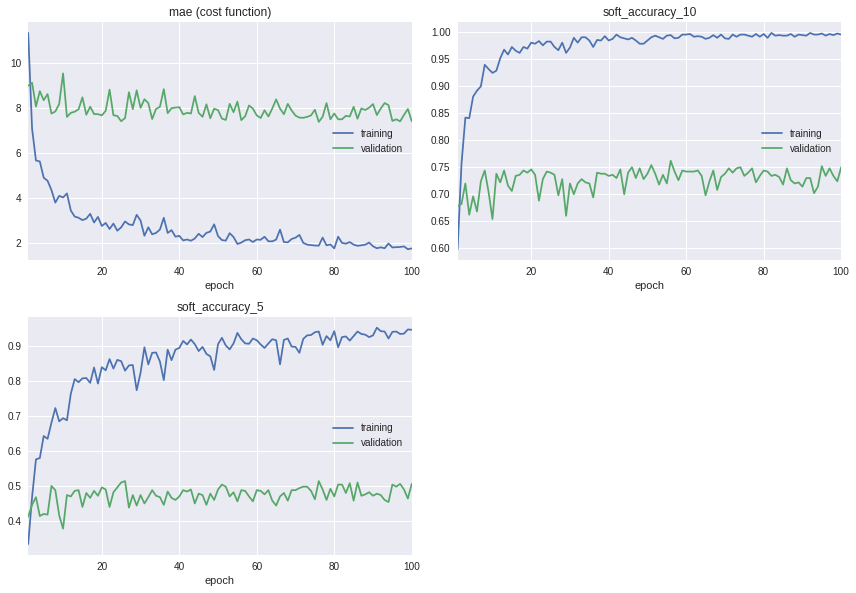

mae (cost function):
training   (min:    1.736, max:   11.318, cur:    1.773)
validation (min:    7.379, max:    9.527, cur:    7.408)

soft_accuracy_10:
training   (min:    0.598, max:    0.999, cur:    0.996)
validation (min:    0.654, max:    0.762, cur:    0.750)

soft_accuracy_5:
training   (min:    0.334, max:    0.953, cur:    0.947)
validation (min:    0.378, max:    0.514, cur:    0.506)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 614us/step
loss: 7.9578933486938475
soft_accuracy_10: 0.717
soft_accuracy_5: 0.476


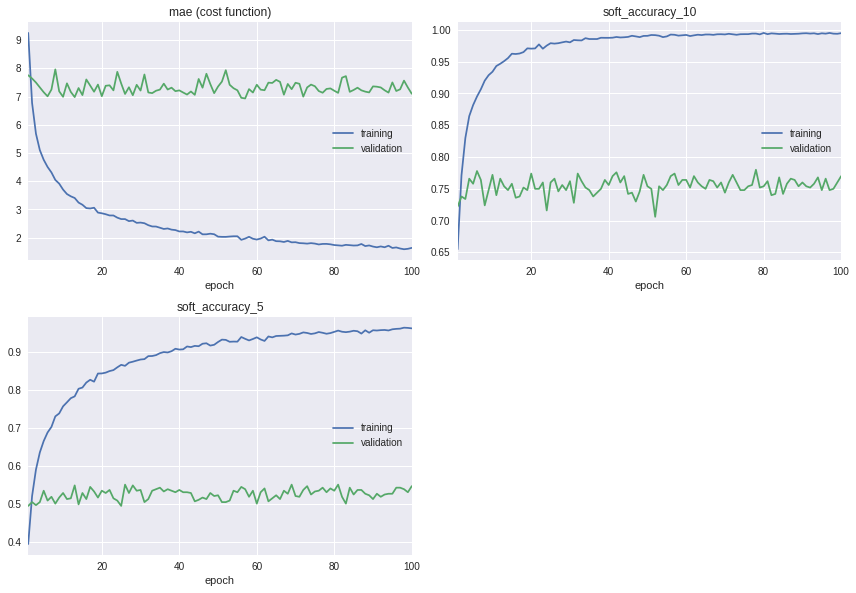

mae (cost function):
training   (min:    1.589, max:    9.254, cur:    1.638)
validation (min:    6.933, max:    7.963, cur:    7.100)

soft_accuracy_10:
training   (min:    0.655, max:    0.995, cur:    0.995)
validation (min:    0.706, max:    0.780, cur:    0.770)

soft_accuracy_5:
training   (min:    0.394, max:    0.963, cur:    0.961)
validation (min:    0.494, max:    0.550, cur:    0.546)


In [110]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [111]:
evaluate_model(model)

1000/1000 [==============================] - 0s 352us/step
loss: 7.780854595184326
soft_accuracy_10: 0.736
soft_accuracy_5: 0.476


## Verison 13

In [112]:
def cnn_v13_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dropout(.5))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='nadam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v13_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v13_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_5 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_17 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_18 (Dense)             (None, 100)               5100      
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 101       
Total params: 5,022,851
Trainable params: 5,022,851
Non-trainable params: 0
_________________________________________________________________


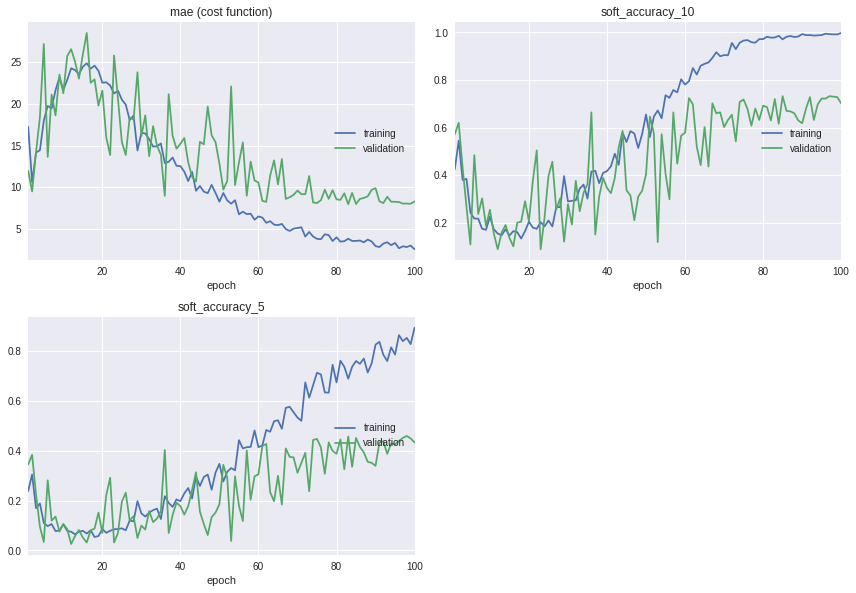

mae (cost function):
training   (min:    2.548, max:   24.874, cur:    2.548)
validation (min:    7.958, max:   28.513, cur:    8.291)

soft_accuracy_10:
training   (min:    0.133, max:    0.998, cur:    0.998)
validation (min:    0.088, max:    0.732, cur:    0.702)

soft_accuracy_5:
training   (min:    0.054, max:    0.895, cur:    0.895)
validation (min:    0.026, max:    0.460, cur:    0.434)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 621us/step
loss: 8.433497932434083
soft_accuracy_10: 0.713
soft_accuracy_5: 0.434


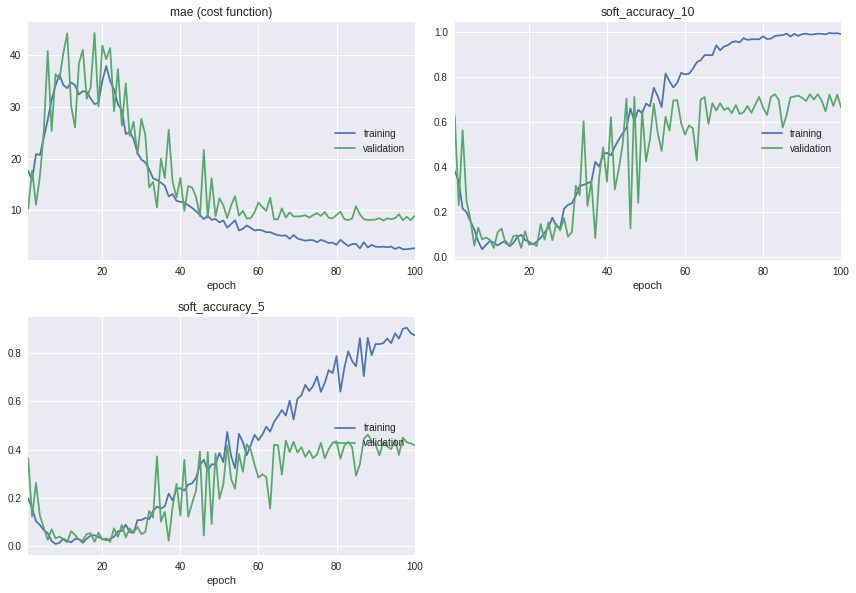

mae (cost function):
training   (min:    2.441, max:   37.951, cur:    2.639)
validation (min:    8.005, max:   44.354, cur:    8.885)

soft_accuracy_10:
training   (min:    0.036, max:    0.996, cur:    0.991)
validation (min:    0.042, max:    0.724, cur:    0.664)

soft_accuracy_5:
training   (min:    0.009, max:    0.905, cur:    0.873)
validation (min:    0.016, max:    0.462, cur:    0.418)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 668us/step
loss: 8.970545364379882
soft_accuracy_10: 0.692
soft_accuracy_5: 0.435


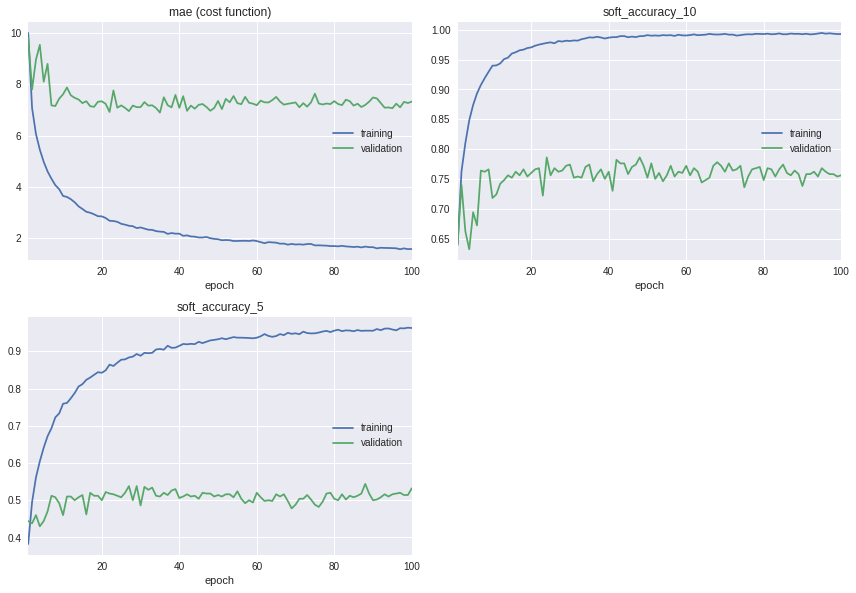

mae (cost function):
training   (min:    1.565, max:   10.006, cur:    1.576)
validation (min:    6.898, max:    9.818, cur:    7.326)

soft_accuracy_10:
training   (min:    0.639, max:    0.995, cur:    0.993)
validation (min:    0.632, max:    0.786, cur:    0.756)

soft_accuracy_5:
training   (min:    0.382, max:    0.964, cur:    0.963)
validation (min:    0.430, max:    0.544, cur:    0.532)


In [113]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [114]:
evaluate_model(model)

1000/1000 [==============================] - 0s 382us/step
loss: 7.929850387573242
soft_accuracy_10: 0.72
soft_accuracy_5: 0.495


## Verison 14

In [115]:
def cnn_v14_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dropout(.5))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adadelta', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v14_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v14_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_6 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_20 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_21 (Dense)             (None, 100)               5100      
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 101       
Total params: 5,022,851
Trainable params: 5,022,851
Non-trainable params: 0
_________________________________________________________________


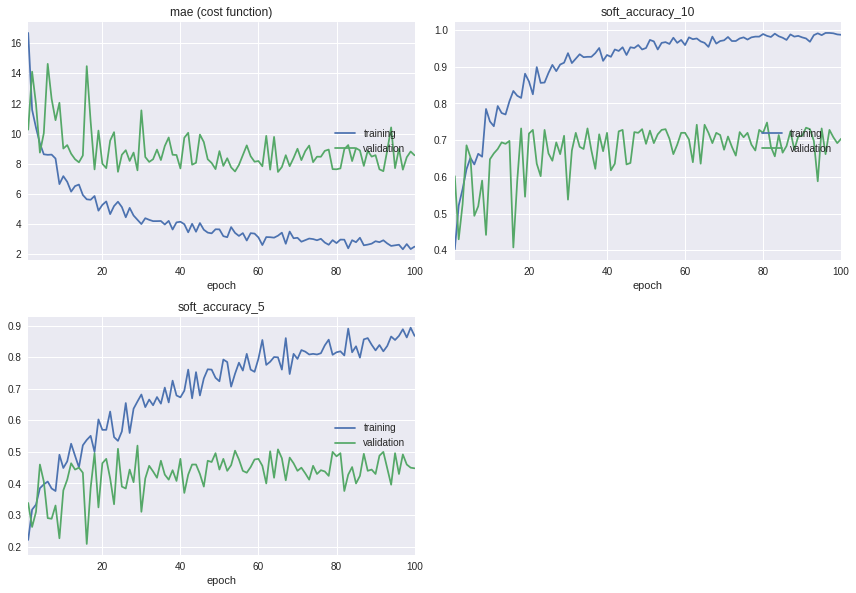

mae (cost function):
training   (min:    2.342, max:   16.672, cur:    2.515)
validation (min:    7.463, max:   14.625, cur:    8.565)

soft_accuracy_10:
training   (min:    0.403, max:    0.992, cur:    0.987)
validation (min:    0.408, max:    0.748, cur:    0.704)

soft_accuracy_5:
training   (min:    0.221, max:    0.894, cur:    0.868)
validation (min:    0.208, max:    0.520, cur:    0.448)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 628us/step
loss: 8.751210983276367
soft_accuracy_10: 0.697
soft_accuracy_5: 0.449


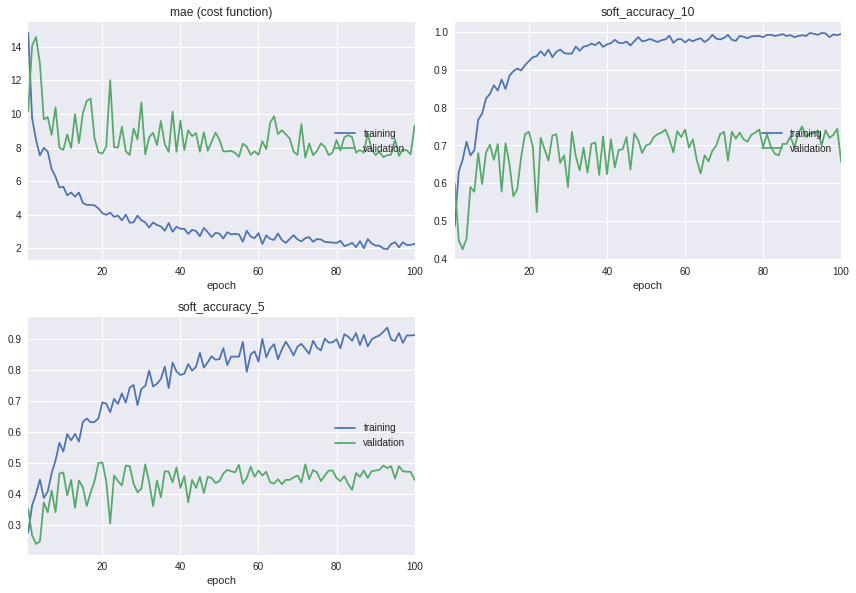

mae (cost function):
training   (min:    1.951, max:   14.826, cur:    2.274)
validation (min:    7.398, max:   14.589, cur:    9.307)

soft_accuracy_10:
training   (min:    0.486, max:    0.997, cur:    0.995)
validation (min:    0.426, max:    0.750, cur:    0.656)

soft_accuracy_5:
training   (min:    0.277, max:    0.935, cur:    0.911)
validation (min:    0.240, max:    0.502, cur:    0.446)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 1s 609us/step
loss: 9.54918360900879
soft_accuracy_10: 0.65
soft_accuracy_5: 0.446


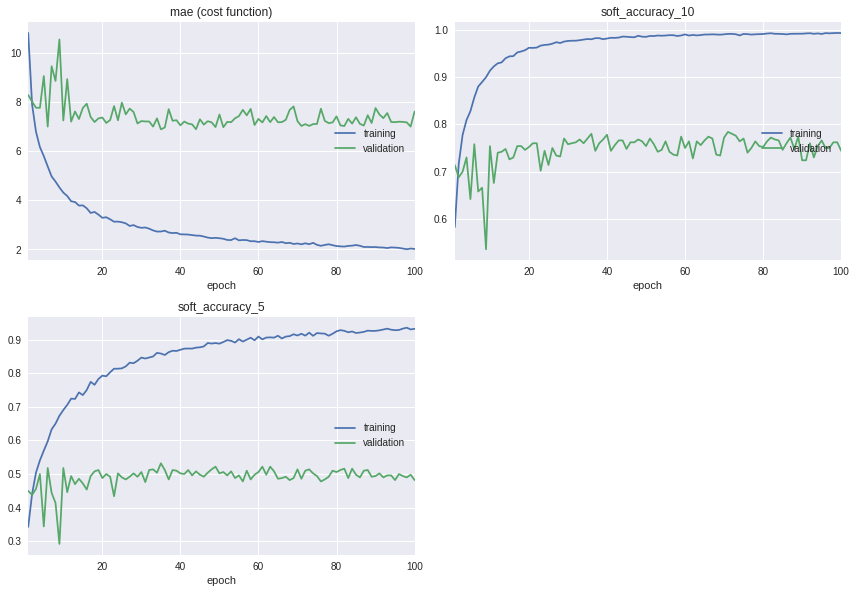

mae (cost function):
training   (min:    2.007, max:   10.808, cur:    2.019)
validation (min:    6.886, max:   10.543, cur:    7.609)

soft_accuracy_10:
training   (min:    0.583, max:    0.993, cur:    0.993)
validation (min:    0.536, max:    0.784, cur:    0.744)

soft_accuracy_5:
training   (min:    0.343, max:    0.935, cur:    0.932)
validation (min:    0.292, max:    0.532, cur:    0.482)


In [116]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [117]:
evaluate_model(model)

1000/1000 [==============================] - 0s 388us/step
loss: 8.17659449005127
soft_accuracy_10: 0.711
soft_accuracy_5: 0.468


## Verison 15

In [118]:
def cnn_v15_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v15_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v15_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_7 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_23 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_24 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_25 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_26 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 51        
Total params: 5,025,351
Trainable params: 5,025,351
Non-trainable params: 0
_________________________________________________________________


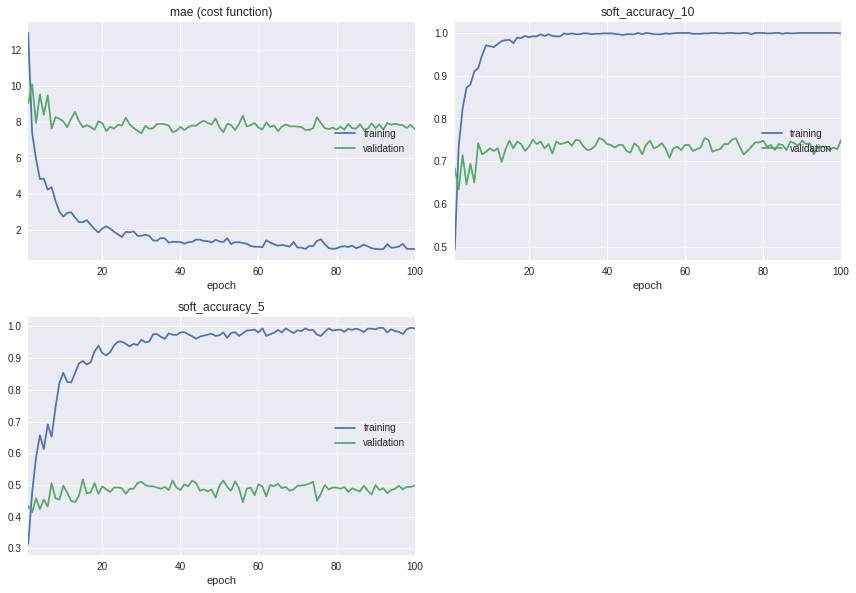

mae (cost function):
training   (min:    0.906, max:   12.943, cur:    0.913)
validation (min:    7.359, max:   10.093, cur:    7.603)

soft_accuracy_10:
training   (min:    0.494, max:    1.000, cur:    0.999)
validation (min:    0.634, max:    0.754, cur:    0.750)

soft_accuracy_5:
training   (min:    0.314, max:    0.996, cur:    0.994)
validation (min:    0.414, max:    0.518, cur:    0.498)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 369us/step
loss: 8.016327766418456
soft_accuracy_10: 0.719
soft_accuracy_5: 0.443


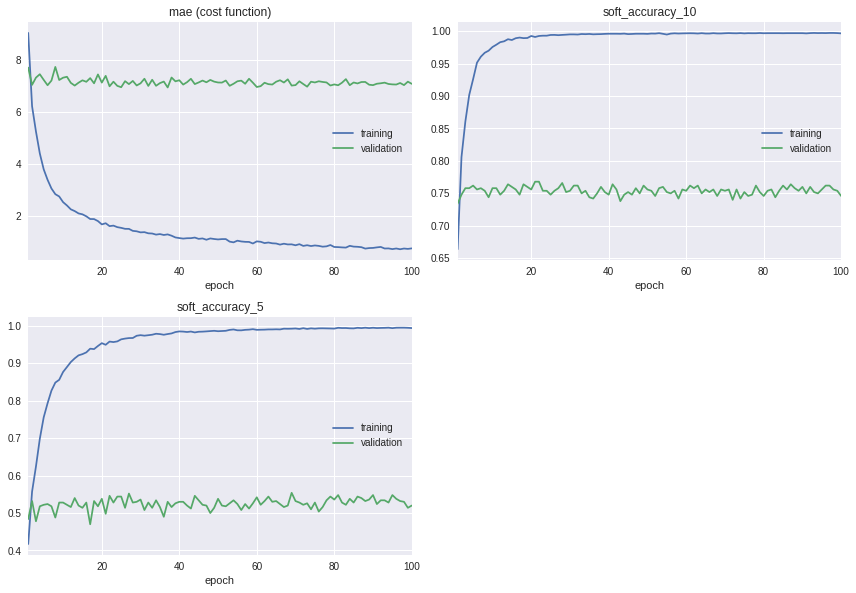

mae (cost function):
training   (min:    0.727, max:    9.040, cur:    0.760)
validation (min:    6.944, max:    7.734, cur:    7.085)

soft_accuracy_10:
training   (min:    0.664, max:    0.997, cur:    0.997)
validation (min:    0.734, max:    0.768, cur:    0.746)

soft_accuracy_5:
training   (min:    0.417, max:    0.995, cur:    0.994)
validation (min:    0.470, max:    0.554, cur:    0.520)


In [119]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [120]:
evaluate_model(model)

1000/1000 [==============================] - 0s 375us/step
loss: 7.368924690246582
soft_accuracy_10: 0.734
soft_accuracy_5: 0.502


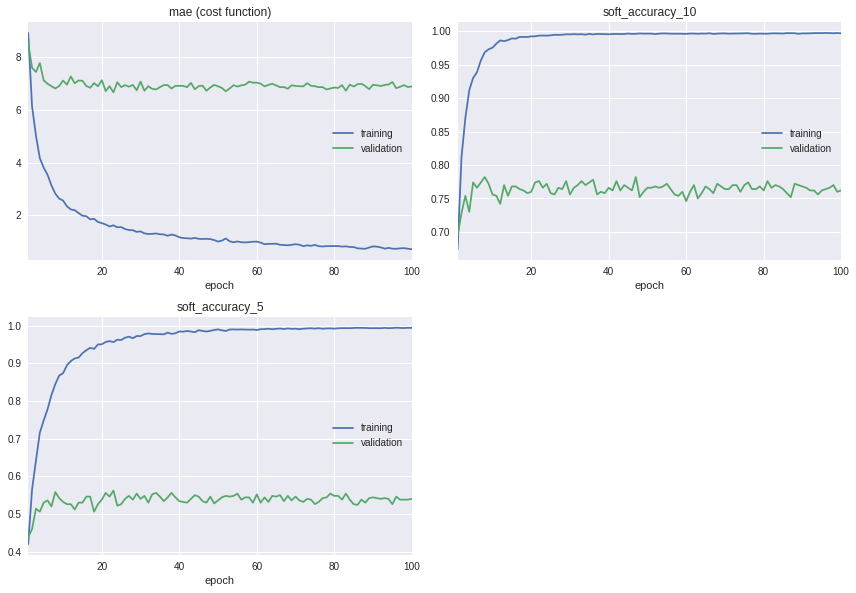

mae (cost function):
training   (min:    0.710, max:    8.928, cur:    0.710)
validation (min:    6.671, max:    8.528, cur:    6.897)

soft_accuracy_10:
training   (min:    0.674, max:    0.997, cur:    0.997)
validation (min:    0.694, max:    0.782, cur:    0.762)

soft_accuracy_5:
training   (min:    0.420, max:    0.995, cur:    0.994)
validation (min:    0.438, max:    0.562, cur:    0.540)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 394us/step
loss: 7.148597755432129
soft_accuracy_10: 0.749
soft_accuracy_5: 0.522


## Version 16

In [121]:
def cnn_v16_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v16_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v16_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_8 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_28 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_29 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_30 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_31 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_32 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 51        
Total para

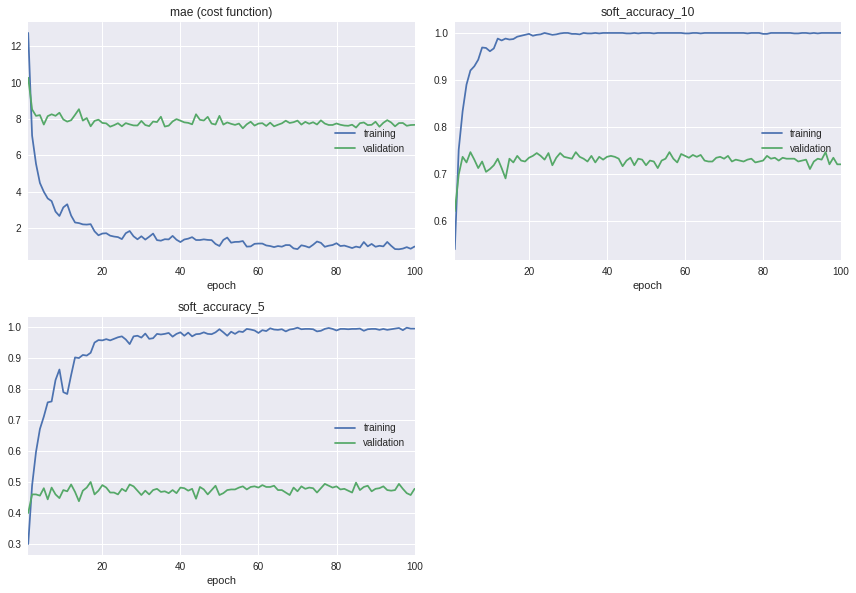

mae (cost function):
training   (min:    0.831, max:   12.729, cur:    0.980)
validation (min:    7.484, max:   10.265, cur:    7.673)

soft_accuracy_10:
training   (min:    0.539, max:    1.000, cur:    1.000)
validation (min:    0.620, max:    0.746, cur:    0.720)

soft_accuracy_5:
training   (min:    0.300, max:    0.998, cur:    0.995)
validation (min:    0.400, max:    0.500, cur:    0.478)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 364us/step
loss: 8.04408585357666
soft_accuracy_10: 0.71
soft_accuracy_5: 0.437


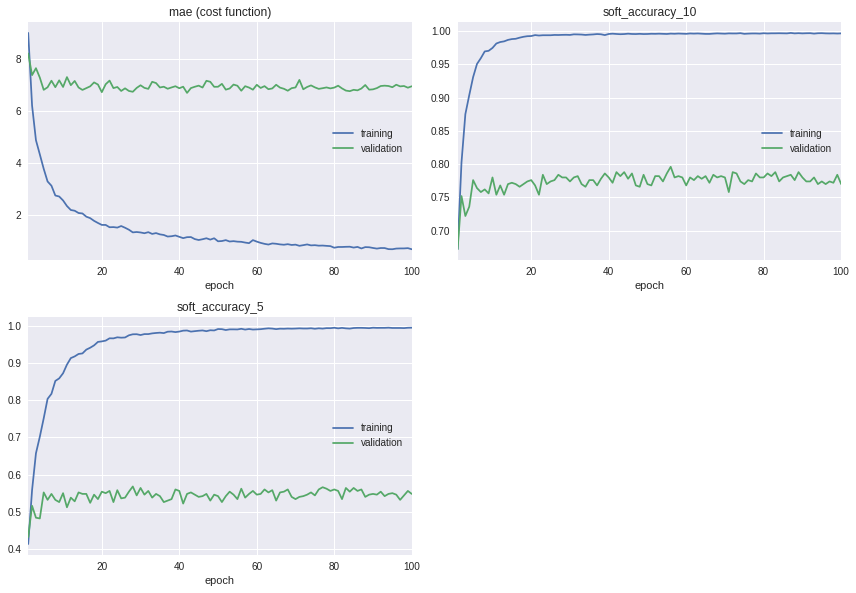

mae (cost function):
training   (min:    0.675, max:    8.984, cur:    0.675)
validation (min:    6.681, max:    8.197, cur:    6.936)

soft_accuracy_10:
training   (min:    0.672, max:    0.997, cur:    0.997)
validation (min:    0.672, max:    0.796, cur:    0.770)

soft_accuracy_5:
training   (min:    0.413, max:    0.995, cur:    0.995)
validation (min:    0.432, max:    0.568, cur:    0.548)


In [122]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [123]:
evaluate_model(model)

1000/1000 [==============================] - 0s 384us/step
loss: 7.2920923461914064
soft_accuracy_10: 0.737
soft_accuracy_5: 0.515


## Version 17

In [124]:
def cnn_v17_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v17_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v17_augmentation_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_9 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_34 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_35 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_36 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_37 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_38 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_39 (Dense)             (None, 50)                2550      
__________

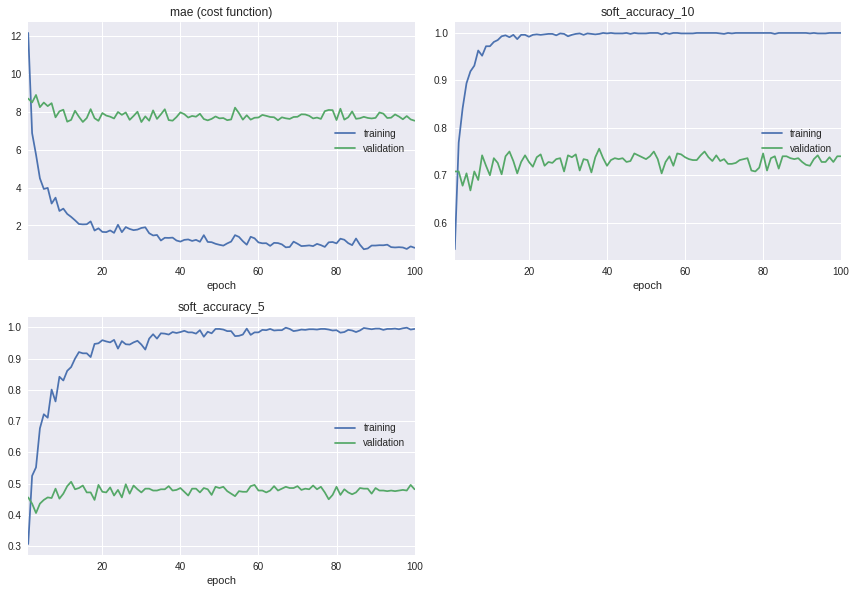

mae (cost function):
training   (min:    0.741, max:   12.183, cur:    0.819)
validation (min:    7.470, max:    8.902, cur:    7.542)

soft_accuracy_10:
training   (min:    0.544, max:    1.000, cur:    1.000)
validation (min:    0.668, max:    0.756, cur:    0.740)

soft_accuracy_5:
training   (min:    0.307, max:    0.999, cur:    0.995)
validation (min:    0.406, max:    0.506, cur:    0.482)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 406us/step
loss: 7.982077743530273
soft_accuracy_10: 0.711
soft_accuracy_5: 0.45


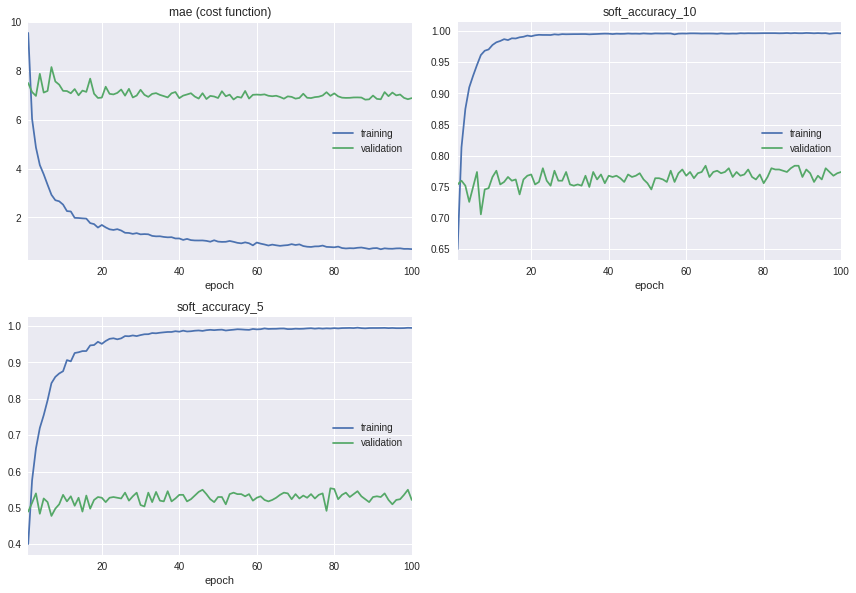

mae (cost function):
training   (min:    0.699, max:    9.548, cur:    0.704)
validation (min:    6.819, max:    8.152, cur:    6.882)

soft_accuracy_10:
training   (min:    0.650, max:    0.997, cur:    0.997)
validation (min:    0.706, max:    0.784, cur:    0.774)

soft_accuracy_5:
training   (min:    0.401, max:    0.996, cur:    0.995)
validation (min:    0.478, max:    0.554, cur:    0.522)


In [125]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [126]:
evaluate_model(model)

1000/1000 [==============================] - 0s 404us/step
loss: 7.3598095932006835
soft_accuracy_10: 0.727
soft_accuracy_5: 0.504


## Version 18

In [127]:
def cnn_v18_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dropout(.5))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(BatchNormalization())
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v18_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v18_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_10 (Flatten)         (None, 100352)            0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_41 (Dense)             (None, 50)                5017650   
_________________________________________________________________
dense_42 (Dense)             (None, 50)                2550      
_________________________________________________________________
dense_43 (Dense)             (None, 50)                2550      
_________________________________________________________________
batch_normalization_1 (Batch (None, 50)                200       
_________________________________________________________________
dense_44 (Dense)             (None, 50)                2550      
__________

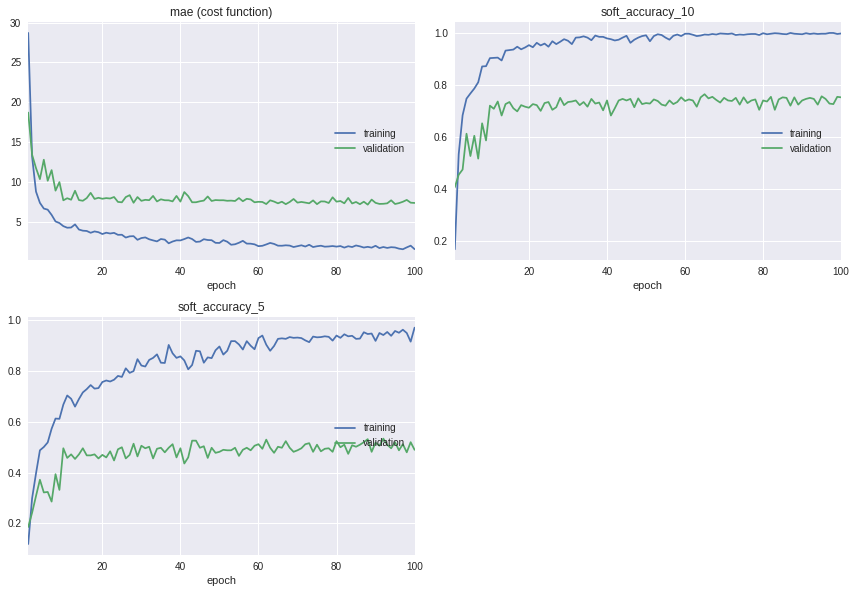

mae (cost function):
training   (min:    1.528, max:   28.704, cur:    1.543)
validation (min:    7.134, max:   18.697, cur:    7.346)

soft_accuracy_10:
training   (min:    0.167, max:    1.000, cur:    0.998)
validation (min:    0.406, max:    0.764, cur:    0.752)

soft_accuracy_5:
training   (min:    0.119, max:    0.971, cur:    0.971)
validation (min:    0.186, max:    0.534, cur:    0.490)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 383us/step
loss: 7.838896171569824
soft_accuracy_10: 0.711
soft_accuracy_5: 0.482


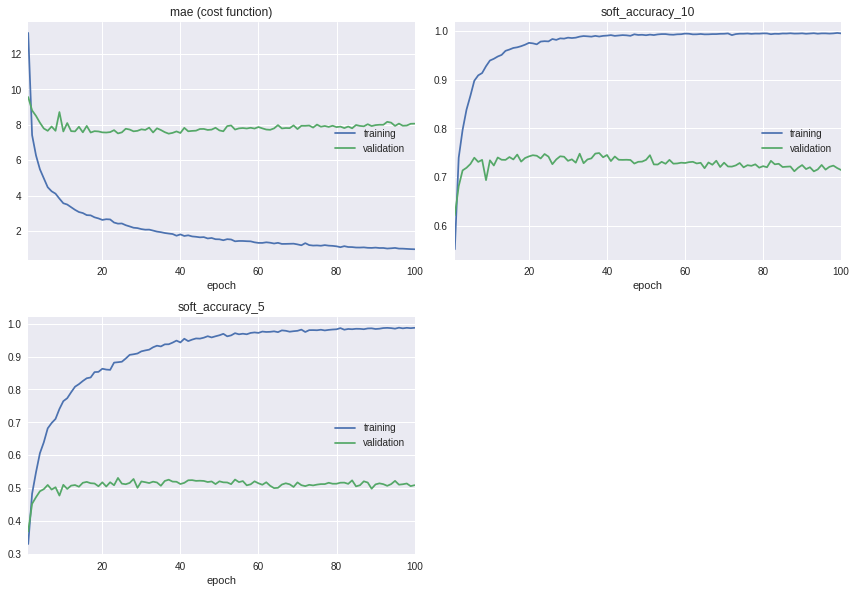

mae (cost function):
training   (min:    0.973, max:   13.192, cur:    0.973)
validation (min:    7.502, max:    9.570, cur:    8.068)

soft_accuracy_10:
training   (min:    0.552, max:    0.996, cur:    0.995)
validation (min:    0.622, max:    0.750, cur:    0.715)

soft_accuracy_5:
training   (min:    0.331, max:    0.988, cur:    0.987)
validation (min:    0.369, max:    0.532, cur:    0.510)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 365us/step
loss: 7.679821285247803
soft_accuracy_10: 0.721
soft_accuracy_5: 0.491


## Verison 19

In [0]:
def cnn_v19_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v19_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v19_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_7 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_36 (Dense)             (None, 100)               10035300  
_________________________________________________________________
dense_37 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_38 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_39 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_40 (Dense)             (None, 1)                 101       
Total params: 10,065,701
Trainable params: 10,065,701
Non-trainable params: 0
________________________________________________________________

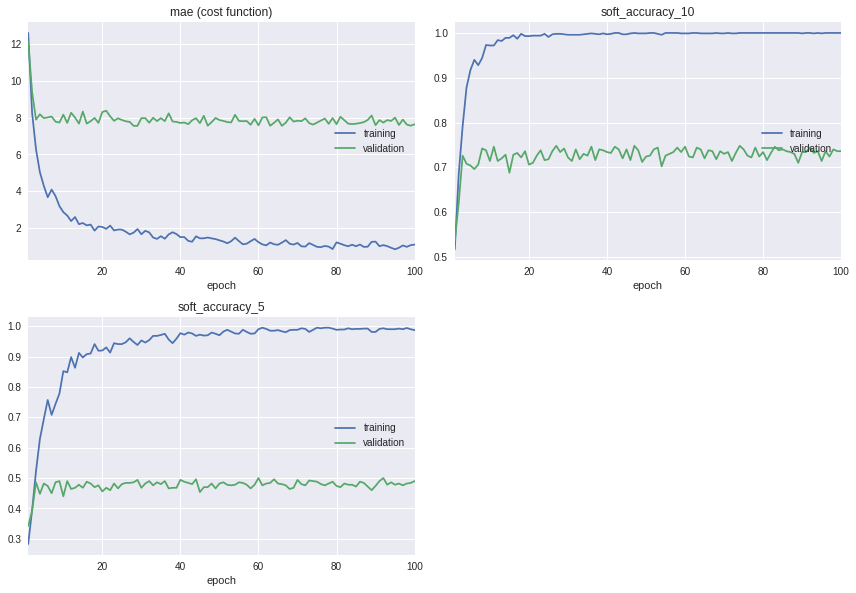

mae (cost function):
training   (min:    0.855, max:   12.592, cur:    1.108)
validation (min:    7.550, max:   12.124, cur:    7.634)

soft_accuracy_10:
training   (min:    0.517, max:    1.000, cur:    1.000)
validation (min:    0.536, max:    0.748, cur:    0.736)

soft_accuracy_5:
training   (min:    0.283, max:    0.995, cur:    0.987)
validation (min:    0.342, max:    0.500, cur:    0.490)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 377us/step
loss: 8.006445228576661
soft_accuracy_10: 0.706
soft_accuracy_5: 0.441


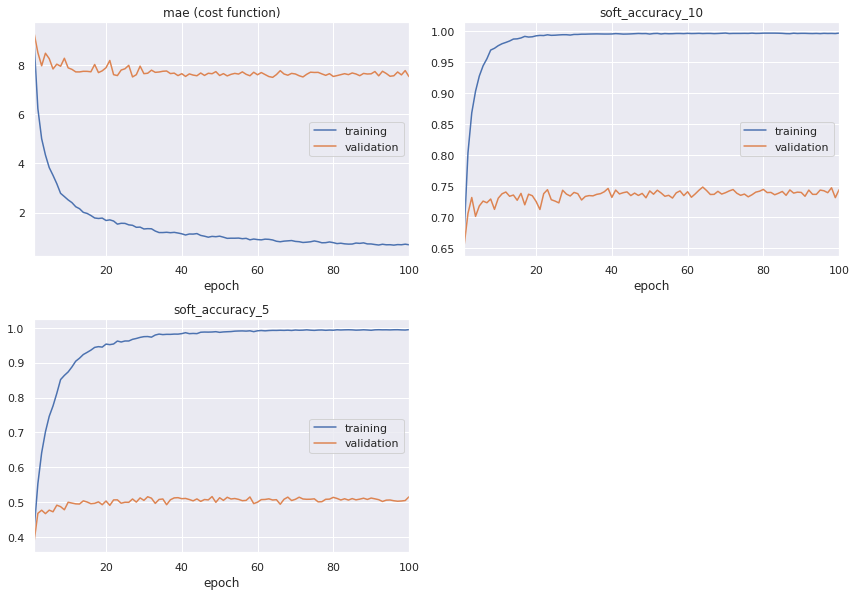

mae (cost function):
training   (min:    0.675, max:    8.937, cur:    0.690)
validation (min:    7.493, max:    9.292, cur:    7.522)

soft_accuracy_10:
training   (min:    0.675, max:    0.997, cur:    0.997)
validation (min:    0.655, max:    0.748, cur:    0.744)

soft_accuracy_5:
training   (min:    0.420, max:    0.995, cur:    0.995)
validation (min:    0.387, max:    0.516, cur:    0.516)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 370us/step
loss: 7.1418922424316404
soft_accuracy_10: 0.747
soft_accuracy_5: 0.521


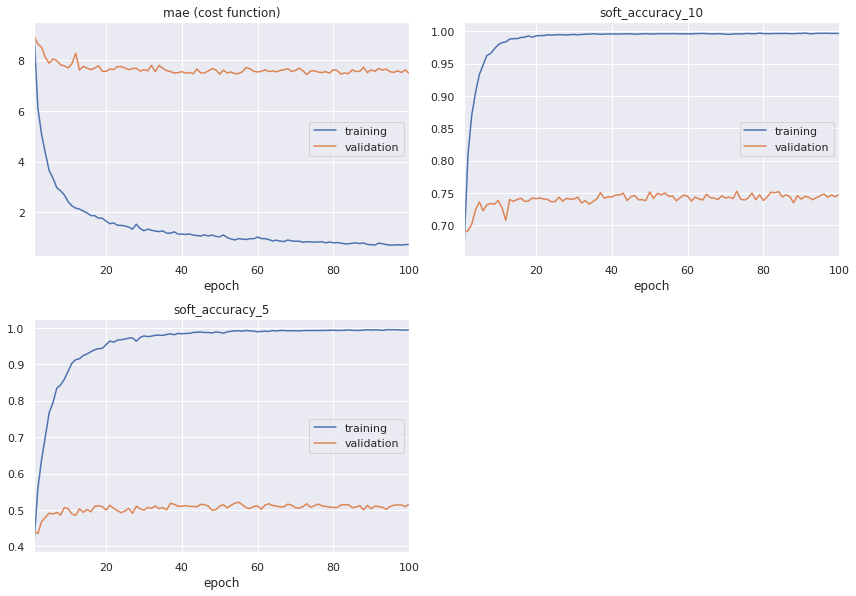

mae (cost function):
training   (min:    0.694, max:    9.083, cur:    0.717)
validation (min:    7.444, max:    8.950, cur:    7.496)

soft_accuracy_10:
training   (min:    0.669, max:    0.997, cur:    0.997)
validation (min:    0.690, max:    0.752, cur:    0.748)

soft_accuracy_5:
training   (min:    0.413, max:    0.995, cur:    0.995)
validation (min:    0.435, max:    0.522, cur:    0.516)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 357us/step
loss: 7.250388481140137
soft_accuracy_10: 0.745
soft_accuracy_5: 0.51


## Verison 20

In [0]:
def cnn_v20_model(input_shape):
    model = Sequential()
    model.add(Flatten(input_shape=input_shape[1:]))
    model.add(Dense(100, activation='relu', kernel_initializer='normal'))
    model.add(Dense(100, activation='relu', kernel_initializer='normal'))
    model.add(Dense(100, activation='relu', kernel_initializer='normal'))
    model.add(Dense(100, activation='relu', kernel_initializer='normal'))
    model.add(Dense(1, kernel_initializer='normal'))
    model.compile(loss='mae', optimizer='adam', metrics=[soft_accuracy_10, soft_accuracy_5])
    return model

model = cnn_v20_model(train_data_features.shape)      
model.summary()

checkpointer = ModelCheckpoint(filepath=features_folder + 'v20_weights.best.hdf5', 
                               verbose=1, save_best_only=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_8 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dense_41 (Dense)             (None, 100)               10035300  
_________________________________________________________________
dense_42 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_43 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_44 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_45 (Dense)             (None, 1)                 101       
Total params: 10,065,701
Trainable params: 10,065,701
Non-trainable params: 0
________________________________________________________________

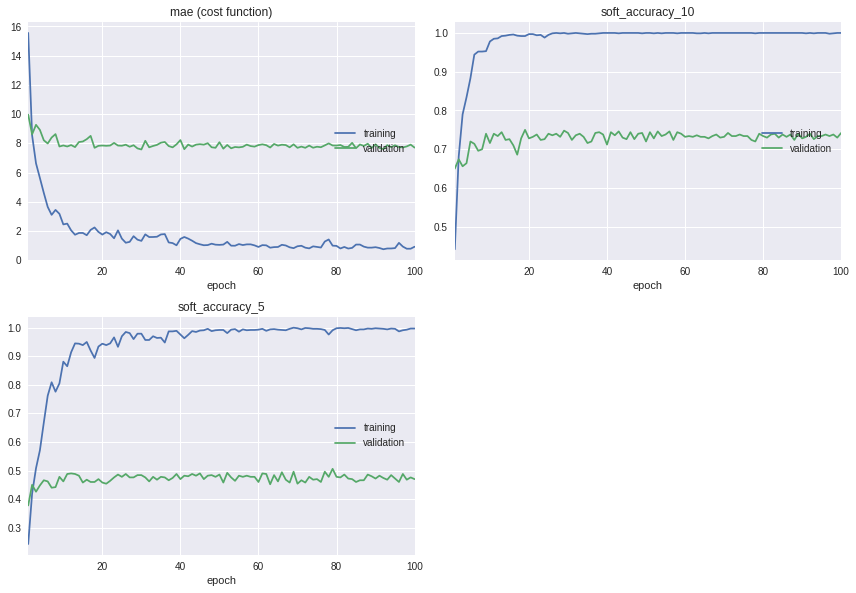

mae (cost function):
training   (min:    0.750, max:   15.556, cur:    0.922)
validation (min:    7.580, max:    9.964, cur:    7.708)

soft_accuracy_10:
training   (min:    0.442, max:    1.000, cur:    1.000)
validation (min:    0.650, max:    0.750, cur:    0.742)

soft_accuracy_5:
training   (min:    0.243, max:    1.000, cur:    0.997)
validation (min:    0.378, max:    0.506, cur:    0.470)


In [0]:
run_model(model)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 355us/step
loss: 8.046090721130371
soft_accuracy_10: 0.716
soft_accuracy_5: 0.454


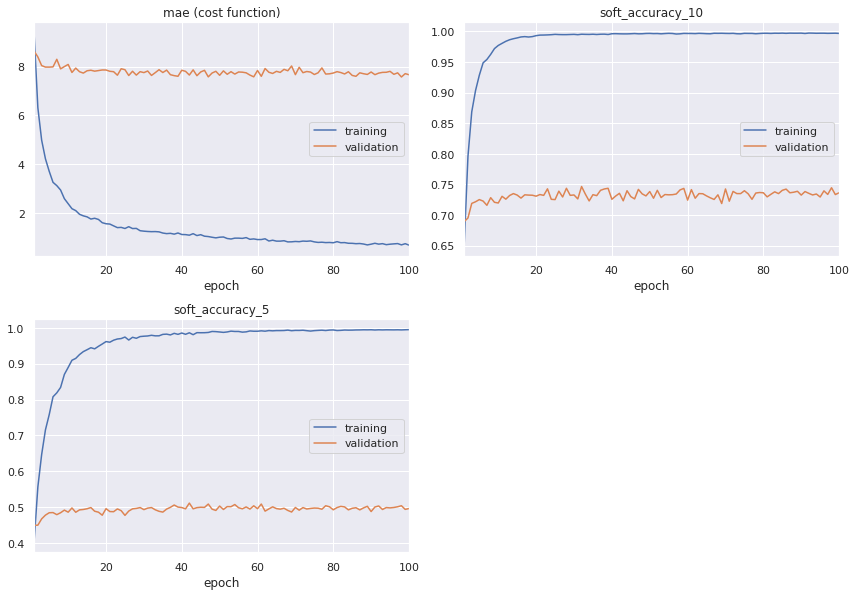

mae (cost function):
training   (min:    0.674, max:    9.373, cur:    0.674)
validation (min:    7.572, max:    8.639, cur:    7.664)

soft_accuracy_10:
training   (min:    0.651, max:    0.997, cur:    0.997)
validation (min:    0.689, max:    0.747, cur:    0.736)

soft_accuracy_5:
training   (min:    0.403, max:    0.995, cur:    0.995)
validation (min:    0.449, max:    0.511, cur:    0.496)


In [0]:
run_model(model, x=train_data_features_augmented, y=train_targets_augmented)

In [0]:
evaluate_model(model)

1000/1000 [==============================] - 0s 330us/step
loss: 7.1846688385009765
soft_accuracy_10: 0.747
soft_accuracy_5: 0.506


# Image Augmentation

In here we evaluate the need for image augmentation by looking at some sample modifications.

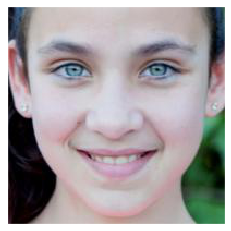

In [0]:
def process_augmentation_demo(input_path, im_generator, save_file_name=None):
    img = image.img_to_array(image.load_img(input_path))
    img = img.reshape((1,) + img.shape)
    img_flow = im_generator.flow(img, batch_size=1)
    fig, axes = plt.subplots(4,4, figsize=(20,20))
    for i, img in enumerate(img_flow):
        new_image = image.array_to_img(img[0], scale=True)
        ax = axes[i//4, i%4] # figure out the location
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        ax.imshow(new_image)
        # let's just get 16 images
        if i == 15:
            break
    if save_file_name:
        plt.savefig(save_file_name)
            
# This is the image we will use as a sample

sample_image = image_location + train_data['Name'][0]

fig = plt.imshow(image.load_img(sample_image))
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)

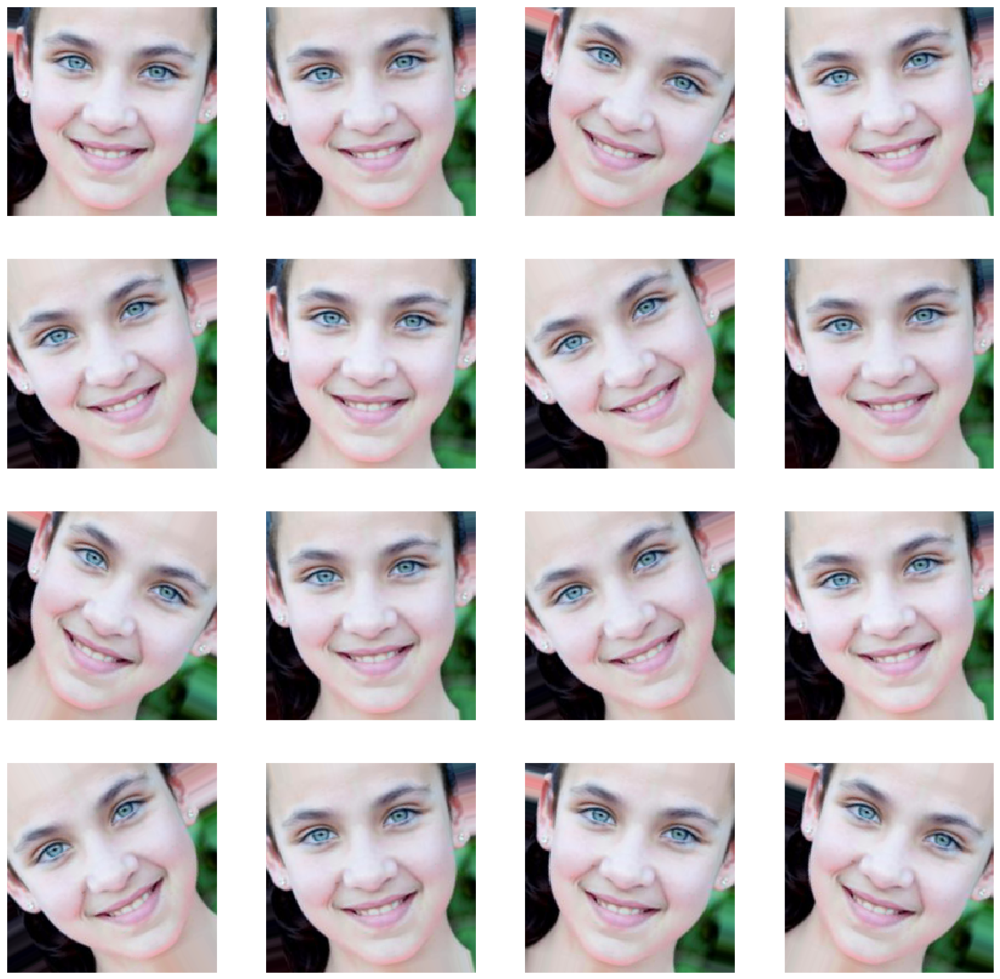

In [0]:
# rotation: This is not necessary since we use aligned photos, and plan to crop and align faces we recieve as input
process_augmentation_demo(sample_image, image.ImageDataGenerator(rotation_range=30))

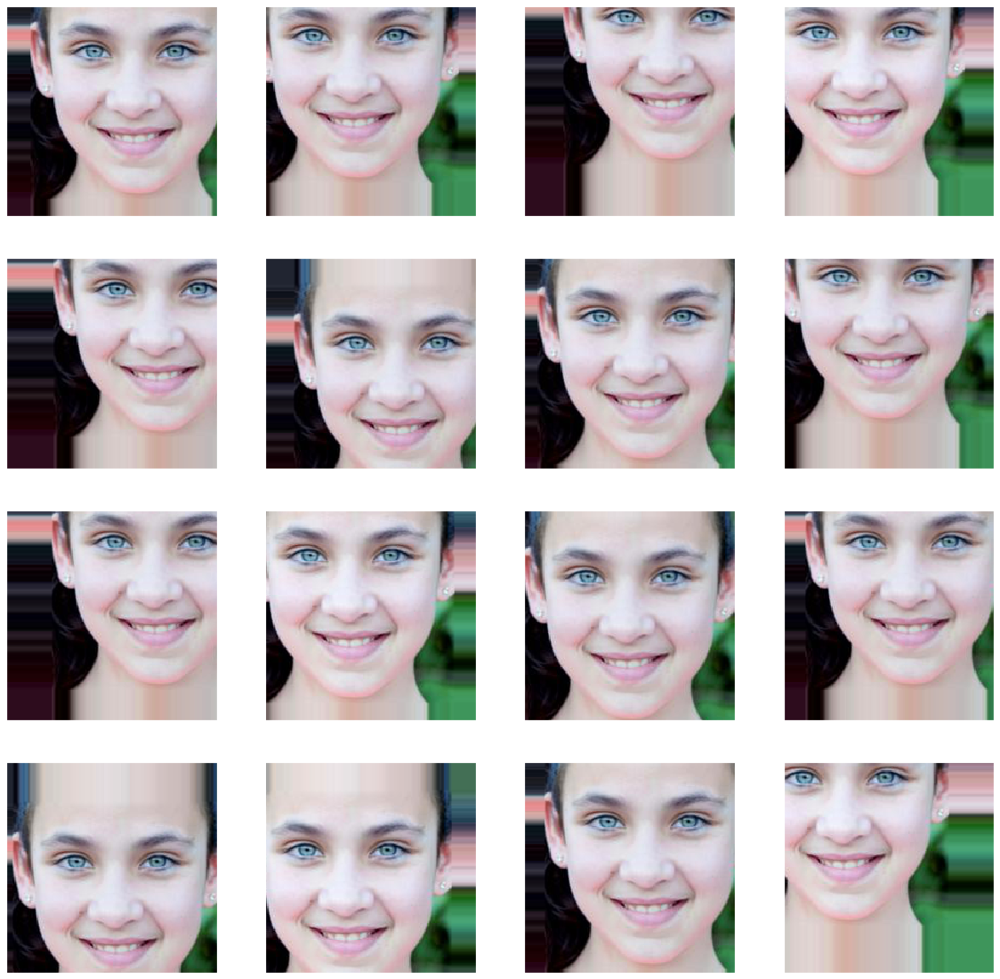

In [0]:
# shift range: This is not useful since we will center around the face using landmark detection.
process_augmentation_demo(sample_image, image.ImageDataGenerator(width_shift_range=50, height_shift_range=50))

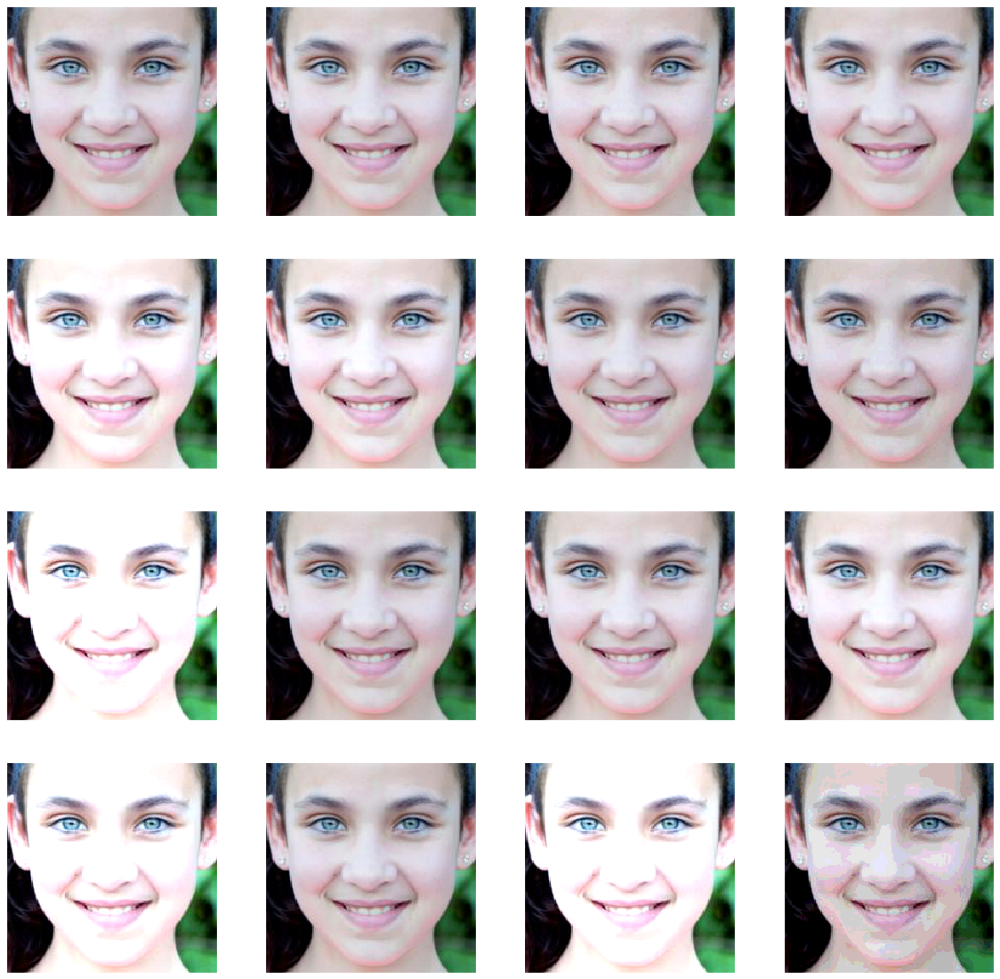

In [0]:
# brightness_range: This is a useful one we can use
process_augmentation_demo(sample_image, image.ImageDataGenerator(brightness_range=[0, 1.5]))

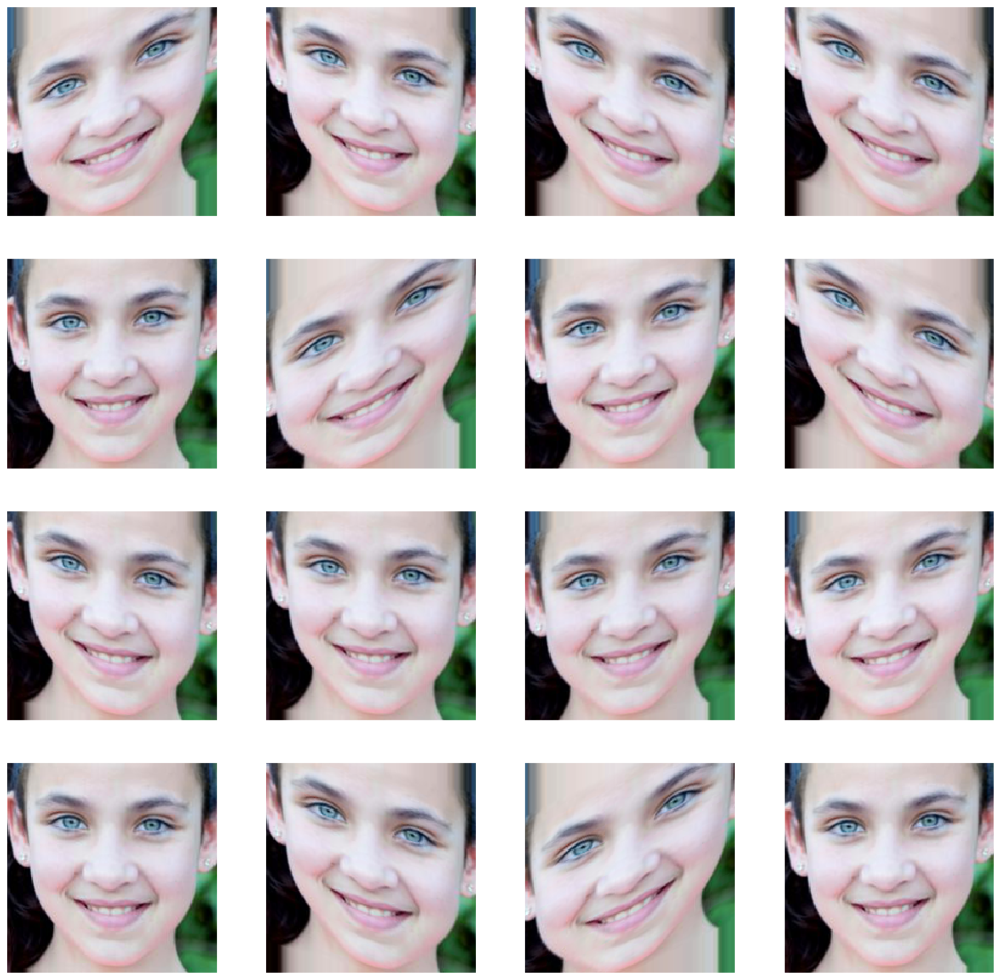

In [0]:
# shear_range: We could possibly benefit from this, even though the shear is unnatural
process_augmentation_demo(sample_image, image.ImageDataGenerator(shear_range=30))

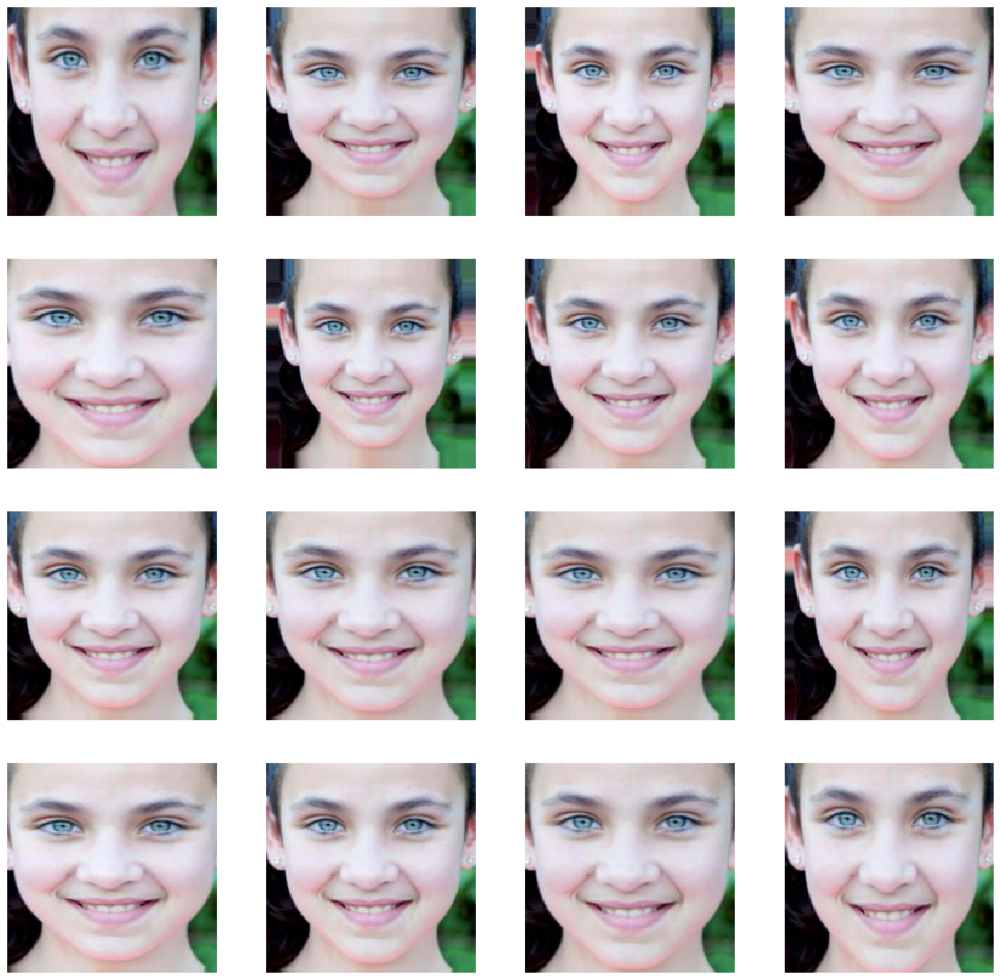

In [0]:
# zoom_range: A small value of this could be useful
process_augmentation_demo(sample_image, image.ImageDataGenerator(zoom_range=.2))

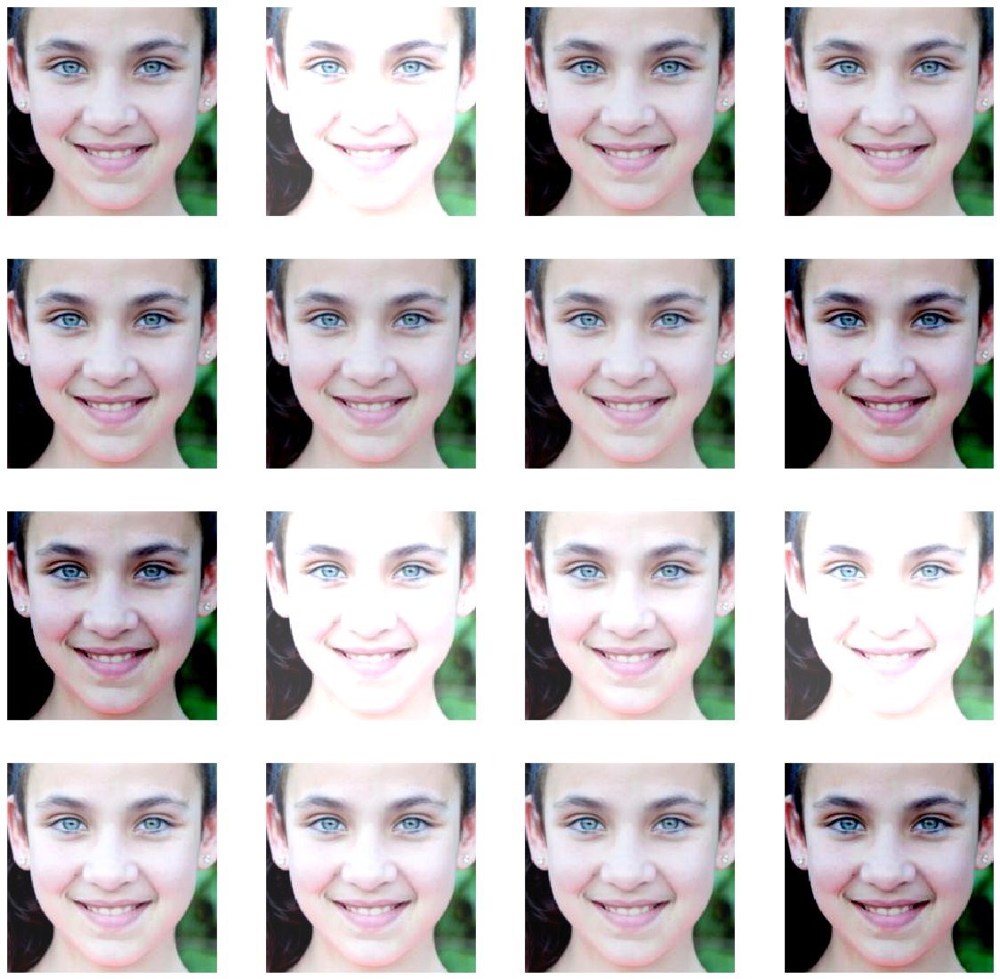

In [0]:
# channel_shift_range: Could make our data more robust
process_augmentation_demo(sample_image, image.ImageDataGenerator(channel_shift_range=70))

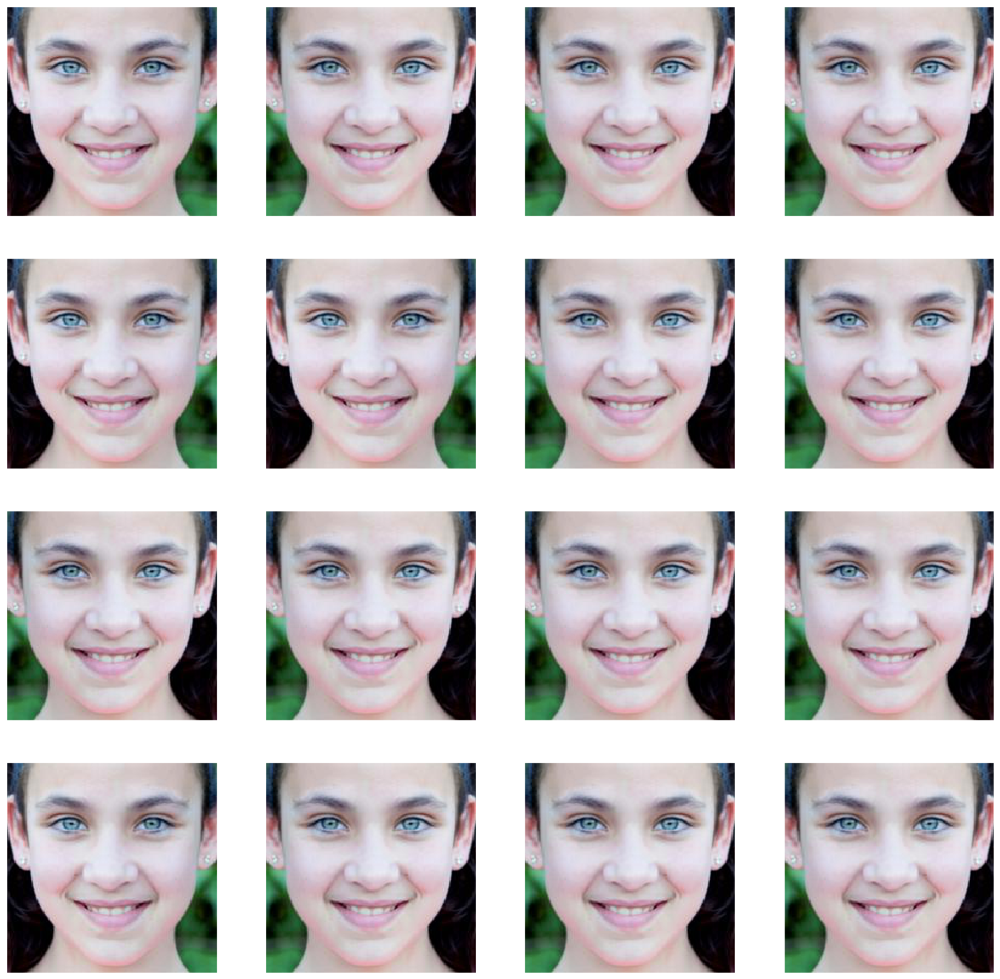

In [0]:
# flip: The vertical flip is not good, however, having a horizontal flip would be good
process_augmentation_demo(sample_image, image.ImageDataGenerator(vertical_flip=False, horizontal_flip=True))

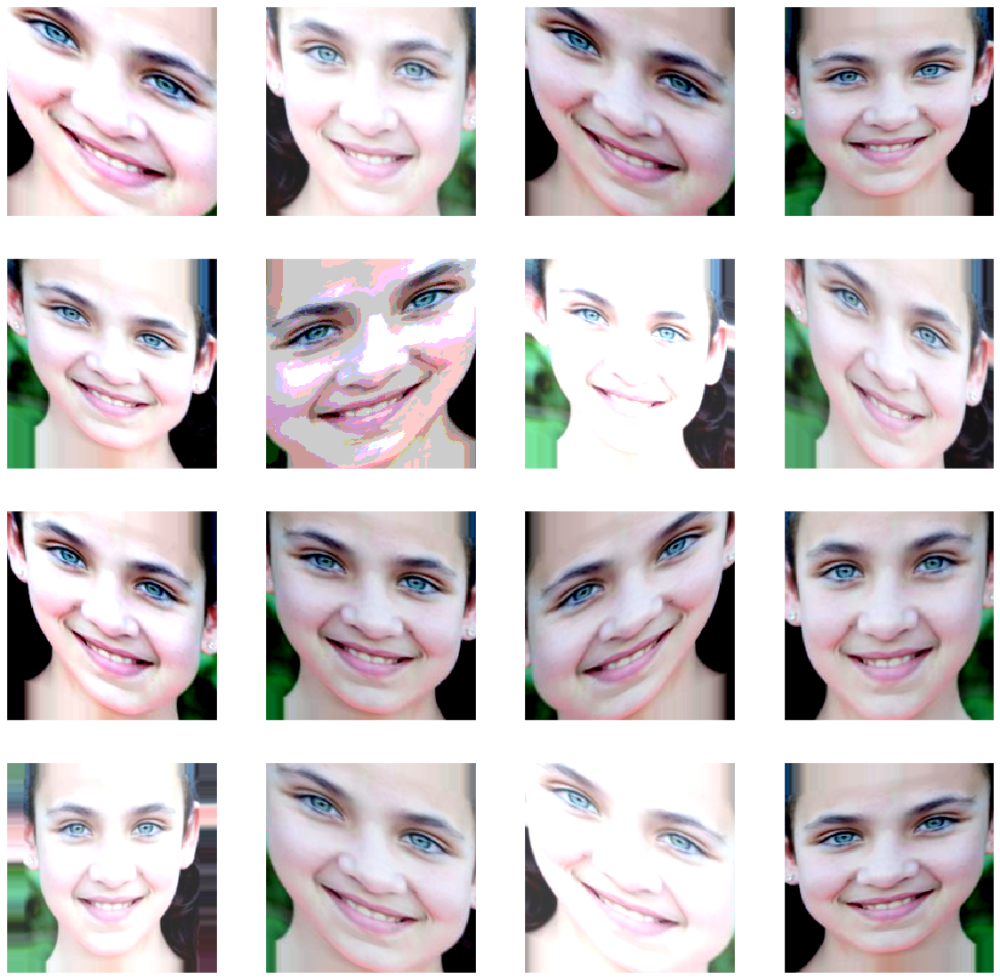

In [0]:
# let's put the ones we sant to use together
def get_augmentation_data():
    return image.ImageDataGenerator(
        brightness_range=[0, 1.5],
        shear_range=30,
        zoom_range=.2,
        channel_shift_range=70,
        vertical_flip=False, horizontal_flip=True)
process_augmentation_demo(sample_image, get_augmentation_data(), save_file_name='figures/augmentation_sample.png')

In [0]:
# we will generate 8 extra images from each image, this will multiply our training data 9-fold
augmentation_size = 8

def extract_augmentation_features(input_path, im_generator=get_augmentation_data(), augmentation_size = augmentation_size):
    img = image.img_to_array(image.load_img(input_path, target_size=target_size))
    img = img.reshape((1,) + img.shape)
    img_flow = im_generator.flow(img, batch_size=1)
    tensors = []
    for i, tensor  in enumerate(img_flow):
        tensors.append(np.expand_dims(tensor[0], axis=0))
        if i == augmentation_size - 1:
            break
    return extract_features_from_tensors(np.vstack(tensors), target_size)

def augment_data(data, data_features, augmentation_size=augmentation_size):
    data_features_augmented = data_features.copy()
    data_augmented = data.copy()
    for i, sample in tqdm_notebook(data.iterrows()):
        sample_augmentation = extract_augmentation_features(image_location + sample['Name'])
        data_features_augmented = np.append(data_features_augmented, sample_augmentation, axis=0)
        for j in range(augmentation_size):
            sample_copy = sample.copy()
            sample_copy['Name'] = 'aug_{}_{}'.format(j, sample['Name'])
            data_augmented = data_augmented.append(sample_copy)
    return data_augmented, data_features_augmented

In [0]:
train_data_augmented, train_data_features_augmented = augment_data(train_data, train_data_features)
train_data_augmented.reset_index(drop=True)
train_targets_augmented = train_data_augmented['Age']
np.save(features_folder + 'train_data_features_augmented', train_data_features_augmented)
train_data_augmented.to_csv(processed_folder + 'train_data_augmented.csv')

In [0]:
train_targets_augmented = train_data_augmented['Age']

In [0]:
np.save(features_folder + 'train_data_features_augmented', train_data_features_augmented)
train_data_augmented.to_csv(processed_folder + 'train_data_augmented.csv')

In [0]:
valid_data_augmented, valid_data_features_augmented = augment_data(valid_data, valid_data_features)
valid_data_augmented.reset_index(drop=True)
valid_targets_augmented = valid_data_augmented['Age']
np.save(features_folder + 'valid_data_features_augmented', valid_data_features_augmented)
valid_data_augmented.to_csv(processed_folder + 'valid_data_augmented.csv')

# Adience Benchmark Data Preparation & Analysis

In [16]:
# specify constants

adience_metadata_location = './data/adience_fold_0_data.csv' # that is enough for our purposes
adience_image_location = './data/adience/'
adience_processed_folder = './processed_data/adience/'
adience_features_folder = adience_processed_folder + 'resnet50/'
age_groups = ['0-2', '4-6', '8-13', '15-20', '25-32', '38-43', '48-53', '60+']

In [17]:
# load adience data
def load_adience_data(adience_processed_folder = adience_processed_folder):
    return pd.read_csv(adience_processed_folder + 'adience_data_modified.csv')

def load_adience_features(adience_features_folder = adience_features_folder):
    return np.load(adience_features_folder + 'adience_data_features.npy')

adience_data = load_adience_data()
adience_features = load_adience_features()

In [0]:
adience_data = pd.read_csv(adience_metadata_location, sep='\t')
adience_data = adience_data[adience_data['age'] != 'None']

In [0]:
adience_data.describe()

,face_id,x,y,dx,dy,tilt_ang,fiducial_yaw_angle,fiducial_score
count,4432.000000,4432.000000,4432.000000,4432.000000,4432.000000,4432.000000,4432.000000,4432.000000
mean,179.578520,883.281814,661.348150,731.491652,723.580551,-8.782040,3.428475,74.413809
std,146.781176,640.251332,460.471939,506.782493,479.713314,83.811097,15.467435,38.789739
min,1.000000,0.000000,0.000000,100.000000,100.000000,-200.000000,-45.000000,5.000000
25%,18.000000,358.000000,296.000000,384.000000,388.000000,-85.000000,0.000000,44.000000
50%,186.000000,787.000000,613.500000,618.000000,616.000000,-5.000000,0.000000,72.000000
75%,307.250000,1305.250000,974.250000,854.000000,854.000000,10.000000,0.000000,101.000000
max,479.000000,4983.000000,2752.000000,3264.000000,3225.000000,270.000000,45.000000,206.000000


In [0]:
adience_data.head()

,user_id,original_image,face_id,age,gender,x,y,dx,dy,tilt_ang,fiducial_yaw_angle,fiducial_score
0,30601258@N03,10399646885_67c7d20df9_o.jpg,1,"(25, 32)",f,0,414,1086,1383,-115,30,17
1,30601258@N03,10424815813_e94629b1ec_o.jpg,2,"(25, 32)",m,301,105,640,641,0,0,94
2,30601258@N03,10437979845_5985be4b26_o.jpg,1,"(25, 32)",f,2395,876,771,771,175,-30,74
3,30601258@N03,10437979845_5985be4b26_o.jpg,3,"(25, 32)",m,752,1255,484,485,180,0,47
4,30601258@N03,11816644924_075c3d8d59_o.jpg,2,"(25, 32)",m,175,80,769,768,-75,0,34


In [24]:
# support methods

# get the file name from a row in the metadata
def get_file_name(row, adience_image_location=adience_image_location):
    return adience_image_location + '{}/coarse_tilt_aligned_face.{}.{}'.format(row['user_id'], 
                                                                       row['face_id'], 
                                                                       row['original_image'])
# show. single image
def show_image(img):
    fig = plt.imshow(img)
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)

# show some sample images
def show_sample_adience_images(adience_data=adience_data, show_pred=False, save_file_name=None):
    sample_faces = adience_data.sample(n=16)
    fig, axes = plt.subplots(4,4, figsize=(20,20))
    for i in range(16):
        sample_face = sample_faces.iloc[i]
        file_name = get_file_name(sample_face)
        ax = axes[i//4, i%4] # figure out the location
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if not show_pred:
            ax.set_title('Age:' + age_groups[sample_face['age_cat']-1])
        else:
            ax.set_title('Age:' + age_groups[sample_face['age_cat']-1] + ' Predicted: ' + age_groups[sample_face['predicted_cat']-1])
        ax.imshow(image.load_img(file_name))
    if save_file_name:
        plt.savefig(save_file_name)

    

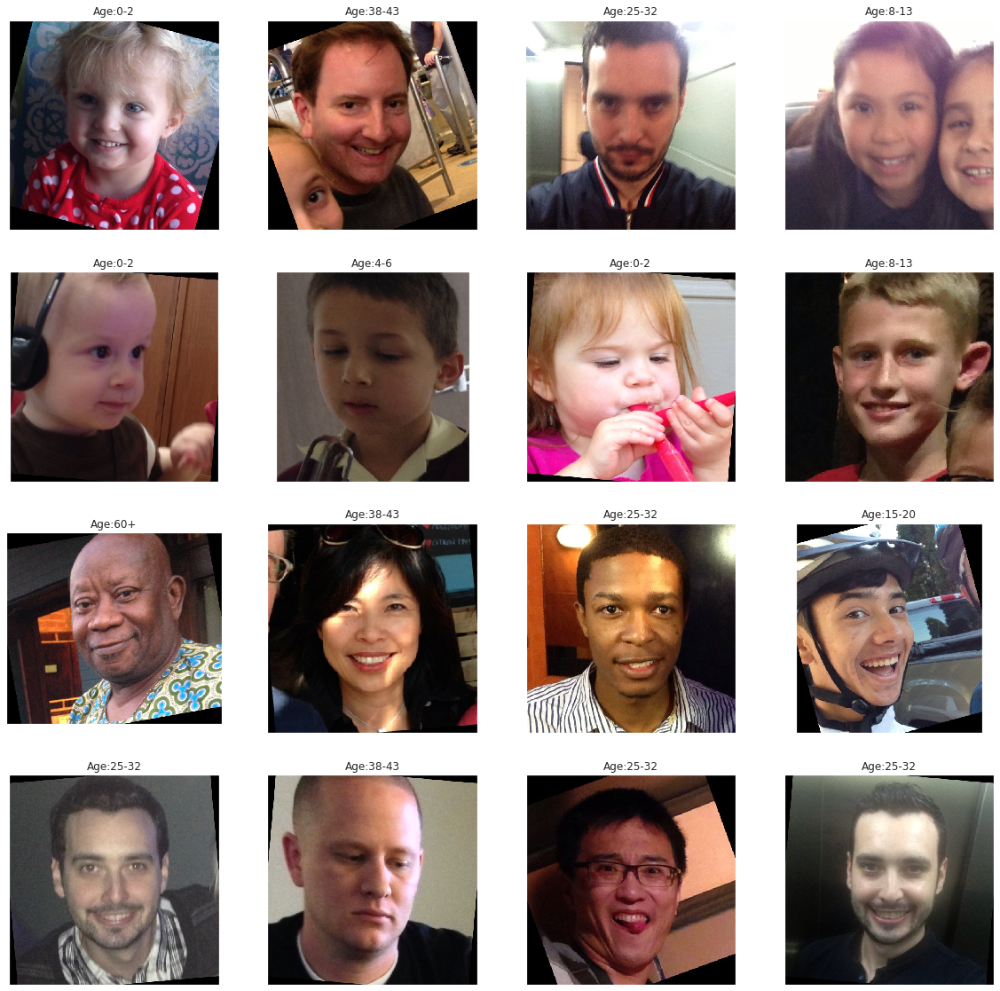

In [0]:
# let us see some sample images

show_sample_adience_images()

In [0]:
tensors = []
for i, sample in tqdm_notebook(adience_data.iterrows()):
    tensors.append(np.expand_dims(detect_face(get_file_name(sample)), axis=0))

cleaned_tensors = []
adience_data = adience_data.copy()
face_detected = pd.Series([])
for i, tensor in enumerate(tensors):
    if tensor.shape == (1,):
        cleaned_tensors.append(path_to_tensor(get_file_name(adience_data.iloc[i]), target_size))
        face_detected.at[i] = False
    else:
        face_detected.at[i] = True
        cleaned_tensors.append(tensor)
        
adience_data['face_detected'] = face_detected

In [0]:
adience_data[adience_data['face_detected'] == False].head()

,user_id,original_image,face_id,age,gender,x,y,dx,dy,tilt_ang,fiducial_yaw_angle,fiducial_score,face_detected
39,30601258@N03,11645266316_5c14b52e4f_o.jpg,2,"(25, 32)",m,115,4,660,660,-70,30,5,False
92,30601258@N03,10343011254_8f847beb9f_o.jpg,5,"(25, 32)",f,257,249,736,711,-95,0,32,False
128,30601258@N03,11141063444_5f3b4d7f7b_o.jpg,2,"(25, 32)",m,540,796,835,836,-85,0,13,False
129,30601258@N03,8684790923_738984c1e6_o.jpg,2,"(25, 32)",m,231,202,817,758,-95,0,19,False
136,30601258@N03,11438238643_075679d25d_o.jpg,2,"(25, 32)",m,1673,541,1371,1371,-75,0,14,False


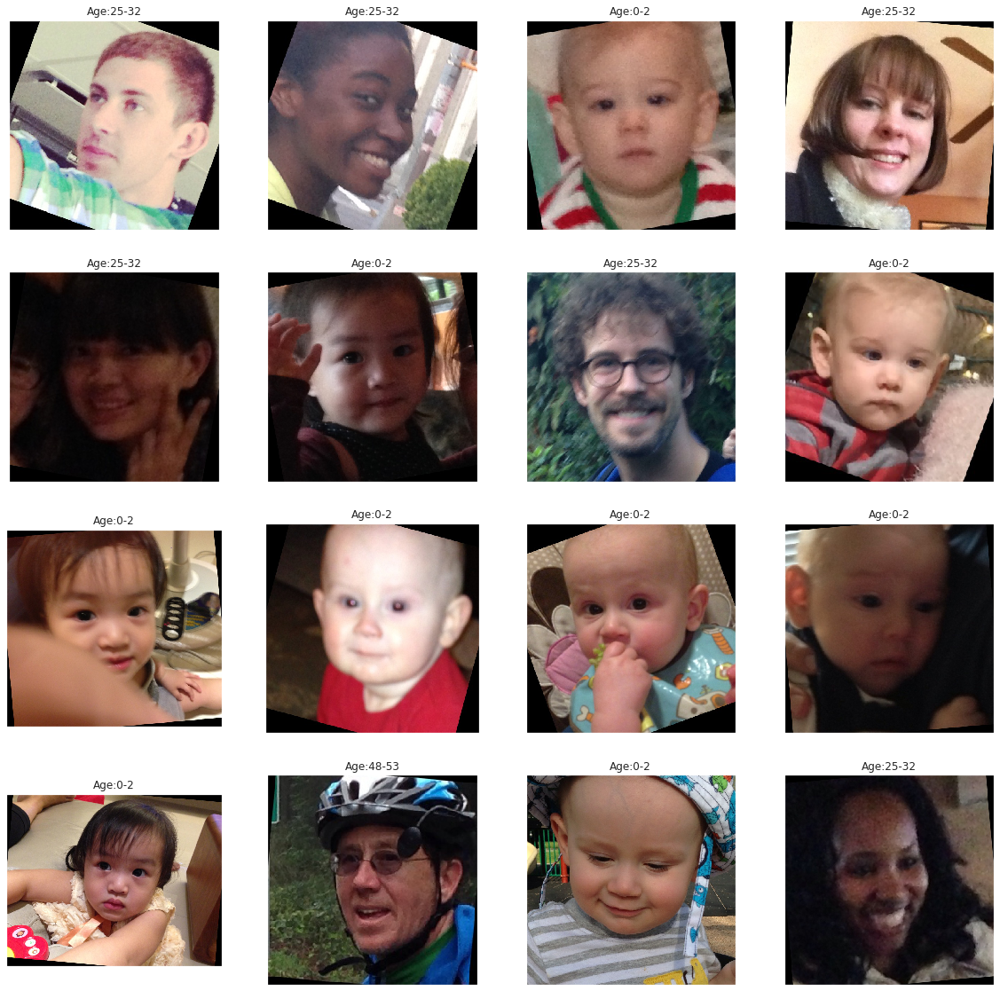

In [0]:
# let us see some sample images that failed face detection; som of the faces are so clear 
# it is very interesting they have not been detected by dlib
# however, some are not frontal images, or faces partially blocked


show_sample_adience_images(adience_data[adience_data['face_detected'] == False], save_file_name='figures/Adience_Faces_Not_Detected.png')

In [0]:
adience_features = extract_features_from_tensors(np.vstack(cleaned_tensors), target_size)
np.save(adience_features_folder + 'adience_data_features', adience_features)
adience_data.to_csv(adience_processed_folder + 'adience_data_modified.csv')

In [18]:
# convert to categories  (0-2, 4-6, 8-13, 15-20, 25-32, 38-43, 48-53, 60-)

def to_category(val):
    if type(val) == str:
        if val == '(0, 2)':
            return 1
        if val == '(4, 6)':
            return 2
        if val == '(8, 12)':
            return 3
        if val == '(15, 20)':
            return 4
        if val == '(25, 32)':
            return 5
        if val == '(38, 43)' or val == '(38, 48)':
            return 6
        if val == '(48, 53)':
            return 7
        if val == '(60, 100)':
            return 8
        val = int(val)
    if val <= 3:
        return 1
    if val <= 7:
        return 2
    if val <= 13.5:
        return 3
    if val <= 22.5:
        return 4
    if val <= 35:
        return 5
    if val <= 45.5:
        return 6
    if val <= 56.5:
        return 7
    return 8
    
adience_data['age_cat'] = adience_data['age'].apply(lambda x: to_category(x))

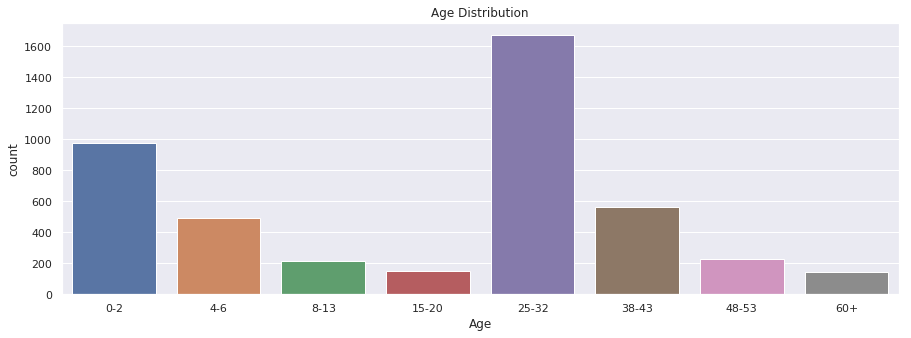

In [0]:
# let us see how the adience data is distributed
def show_distribution():
    fig, ax = plt.subplots(figsize=(15,5))
    g = sns.catplot(x='age_cat', kind="count",  data=adience_data, ax=ax);
    ax.set_xticklabels(age_groups)
    ax.set_title('Age Distribution')
    ax.set_xlabel('Age')
    plt.close(2)
    
show_distribution()

# Model Evaluation

In [0]:
def evaluate_against_adience(model, adience_data=adience_data):
    age_predictions = model.predict(adience_features)
    predictions = list(map(lambda p: to_category(p[0]), age_predictions))
    ct = len(predictions)
    c0 = 0
    c1 = 0
    i = 0
    for y_pred, y_true in zip(predictions, adience_data['age_cat']):
        diff = abs(y_pred - y_true)
        if diff == 0 :
            c0 += 1
        elif diff == 1:
            c1 += 1
        i += 1
    exact = c0 / ct
    one_off = (c0 + c1) / ct
    return exact, one_off



In [52]:
base_model_files = ['v1.2_weights.best', 'v2_weights.best', 'v3_weights.best', 'v4_weights.best',
              'v5_weights.best', 'v6_weights.best', 'v7_weights.best', 'v8_weights.best',
              'v9_weights.best', 'v10_weights.best', 'v11_weights.best', 'v12.2_weights.best',
              'v13_weights.best', 'v14_weights.best', 'v15_weights.best', 'v16_weights.best',
              'v17_weights.best', 'v18_weights.best', 'v19_weights.best', 'v20_weights.best']
  
augmented_model_files = ['v1_augmentation_weights.best', 'v2_augmentation_weights.best', 'v3_augmentation_weights.best', 
               'v4_augmentation_weights.best', 'v5_augmentation_weights.best', 'v6_augmentation_weights.best',
               'v7_augmentation_weights.best', 'v8_augmentation_weights.best', 'v9_augmentation_weights.best',
               'v10_augmentation_weights.best', 'v11_augmentation_weights.best', 'v12_augmentation_weights.best',
               'v13_augmentation_weights.best', 'v14_augmentation_weights.best', 'v15_augmentation_weights.best', 'v16_augmentation_weights.best',
               'v17_augmentation_weights.best', 'v18_augmentation_weights.best', 'v19_augmentation_weights.best', 'v20_augmentation_weights.best']



model_results = pd.DataFrame(columns=['version', 'soft_accuracy_5', 'soft_accuracy_10', 'mae', 
                                      'augmented_soft_accuracy_5', 'augmented_soft_accuracy_10', 'augmented_mae', 
                                      'adience_exact', 'adience_one_off', 'augmented_adience_exact', 'augmented_adience_one_off'])

# let's do it for all the versions we have (ResNet50)

custom_objects = {'soft_accuracy_5': soft_accuracy_5, 'soft_accuracy_10': soft_accuracy_10, 'tilted_loss': tilted_loss}

for version in range(1, 21):
    print('processing version #{}'.format(version))
    i = version - 1 # to use for indexing
    base_model = load_model(features_folder + base_model_files[i] + '.hdf5', custom_objects=custom_objects)
    augmented_model = load_model(features_folder + augmented_model_files[i] + '.hdf5', custom_objects=custom_objects) 

    base_metrics = base_model.evaluate(x=test_data_features, y=test_targets)
    augmented_metrics = augmented_model.evaluate(x=test_data_features, y=test_targets)

    # the indexes in the metrics array are the same, so just get them immediately
    base_mae = base_metrics[0]
    base_soft_accuracy_10 = base_metrics[1]
    base_soft_accuracy_5 = base_metrics[2]


    augmented_mae = augmented_metrics[0]
    augmented_soft_accuracy_10 = augmented_metrics[1]
    augmented_soft_accuracy_5 = augmented_metrics[2]


  
    if version == 6: # we use a different version of loss in this model, so the indexes are different
        base_mae = base_metrics[1]
        base_soft_accuracy_10 = base_metrics[2]
        base_soft_accuracy_5 = base_metrics[3]
        augmented_mae = augmented_metrics[1]
        augmented_soft_accuracy_10 = augmented_metrics[2]
        augmented_soft_accuracy_5 = augmented_metrics[3]

    adience_exact, adience_one_off = evaluate_against_adience(base_model)
    augmented_adience_exact, augmented_adience_one_off = evaluate_against_adience(augmented_model)

    model_results.loc[i] = [version, base_soft_accuracy_5, base_soft_accuracy_10, base_mae, 
                                      augmented_soft_accuracy_5, augmented_soft_accuracy_10, augmented_mae,
                                     adience_exact, adience_one_off, augmented_adience_exact, augmented_adience_one_off]


model_results

processing version #1
1000/1000 [==============================] - 1s 1ms/step
processing version #2
1000/1000 [==============================] - 1s 1ms/step
processing version #3
1000/1000 [==============================] - 1s 1ms/step
processing version #4
1000/1000 [==============================] - 2s 2ms/step
processing version #5
1000/1000 [==============================] - 2s 2ms/step
processing version #6
1000/1000 [==============================] - 2s 2ms/step
processing version #7
1000/1000 [==============================] - 2s 2ms/step
processing version #8
1000/1000 [==============================] - 2s 2ms/step
processing version #9
1000/1000 [==============================] - 2s 2ms/step
processing version #10
1000/1000 [==============================] - 2s 2ms/step
processing version #11
1000/1000 [==============================] - 2s 2ms/step
processing version #12
1000/1000 [==============================] - 3s 3ms/step
processing version #13
1000/1000 [===============

,version,soft_accuracy_5,soft_accuracy_10,mae,augmented_soft_accuracy_5,augmented_soft_accuracy_10,augmented_mae,adience_exact,adience_one_off,augmented_adience_exact,augmented_adience_one_off
0,1.0,0.426,0.694,8.185883,0.438,0.736,7.732486,0.419675,0.770307,0.439079,0.810469
1,2.0,0.422,0.691,8.667407,0.428,0.710,8.344683,0.352888,0.705099,0.409973,0.754964
2,3.0,0.409,0.696,8.724626,0.432,0.705,8.239188,0.328294,0.699910,0.385379,0.724729
3,4.0,0.055,0.129,31.371047,0.441,0.705,8.262741,0.225632,0.354016,0.371390,0.730821
4,5.0,0.419,0.689,8.871970,0.426,0.695,8.511256,0.348150,0.708258,0.380641,0.729242
5,6.0,0.331,0.636,9.242578,0.376,0.651,8.827873,0.275948,0.641922,0.331904,0.688177
6,7.0,0.415,0.673,8.942057,0.451,0.724,7.959620,0.234657,0.549413,0.369134,0.721796
7,8.0,0.406,0.674,8.809910,0.439,0.690,8.227662,0.398466,0.774819,0.455099,0.803700
8,9.0,0.418,0.667,8.963720,0.443,0.697,8.264197,0.421706,0.791516,0.317013,0.807536
9,10.0,0.441,0.704,8.043864,0.490,0.722,7.590221,0.372067,0.772338,0.431634,0.780235


In [0]:
model_results['version'] = model_results['version'].astype(int)
model_results.to_csv('model_results.csv')

In [32]:
def load_model_results():
    return pd.read_csv('model_results.csv')

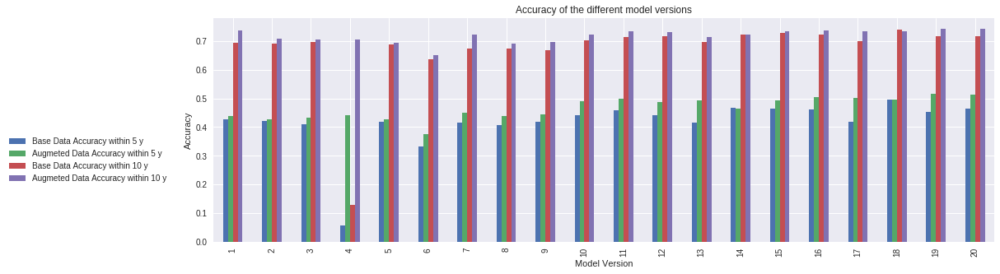

In [61]:
model_results[['version', 'soft_accuracy_5', 'augmented_soft_accuracy_5', 'soft_accuracy_10' , 'augmented_soft_accuracy_10']].plot.bar(x='version', figsize=(17,5))
plt.legend(['Base Data Accuracy within 5 y', 'Augmeted Data Accuracy within 5 y', 'Base Data Accuracy within 10 y', 'Augmeted Data Accuracy within 10 y'], bbox_to_anchor=(-.05, .5))
plt.title('Accuracy of the different model versions')
plt.xlabel('Model Version')
plt.ylabel('Accuracy')
plt.savefig('figures/soft_accuracy_model_version.png')
None


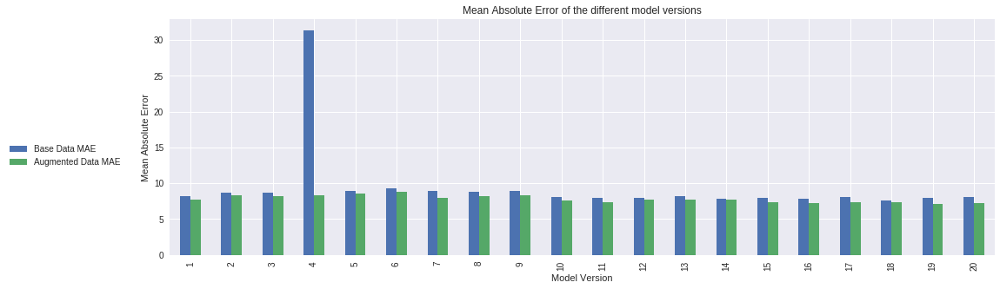

In [66]:
model_results[['version', 'mae', 'augmented_mae']].plot.bar(x='version', figsize=(17,5))
plt.legend(['Base Data MAE', 'Augmented Data MAE'], bbox_to_anchor=(-.05, .5))
plt.title('Mean Absolute Error of the different model versions')
plt.xlabel('Model Version')
plt.ylabel('Mean Absolute Error')
plt.savefig('figures/mae_model_versions.png')
None

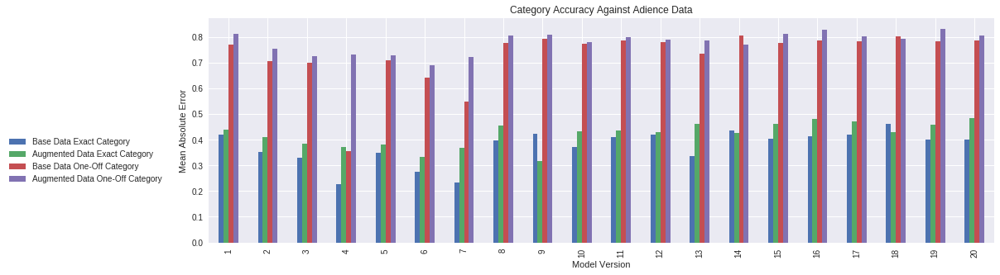

In [67]:
model_results[['version', 'adience_exact', 'augmented_adience_exact', 'adience_one_off', 'augmented_adience_one_off']].plot.bar(x='version', figsize=(17,5))
plt.legend(['Base Data Exact Category', 'Augmented Data Exact Category', 'Base Data One-Off Category', 'Augmented Data One-Off Category'], bbox_to_anchor=(-.05, .5))
plt.title('Category Accuracy Against Adience Data')
plt.xlabel('Model Version')
plt.ylabel('Mean Absolute Error')
plt.savefig('figures/adience_benchmark_model_versions.png')

# Selected Model Analysis

The model selected is version 19.

In [9]:
def load_best_model():
    # the best model we have is version 15 with augmentation, let us load that model
    return load_model(features_folder + 'v19_augmentation_weights.best.hdf5', custom_objects={
                       'soft_accuracy_5': soft_accuracy_5, 'soft_accuracy_10': soft_accuracy_10})

best_model = load_best_model()

In [12]:
y_pred = best_model.predict(test_data_features)
y_pred = np.squeeze(y_pred)
evaluate_model(best_model)

1000/1000 [==============================] - 1s 561us/step
loss: 7.128115921020508
soft_accuracy_10: 0.743
soft_accuracy_5: 0.517


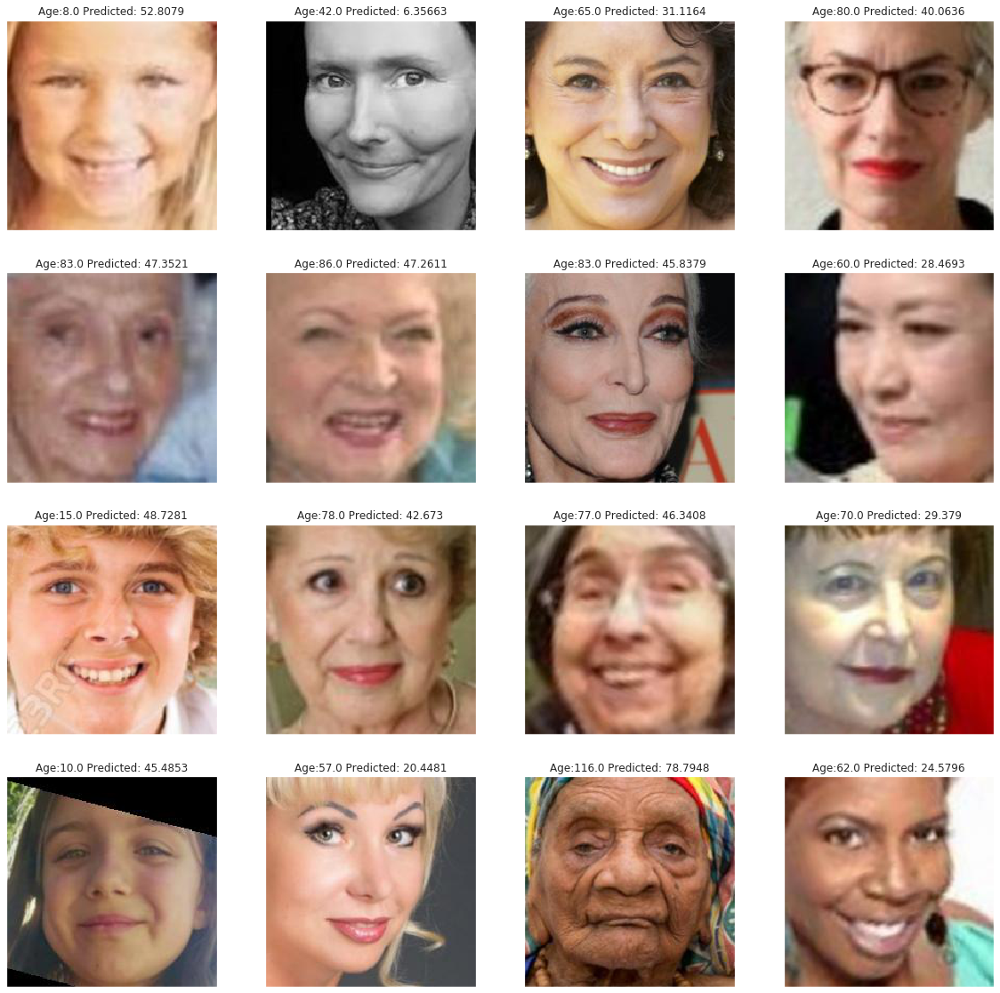

In [13]:
updated_test_data = test_data.copy()
updated_test_data['predicted_age'] = pd.Series(y_pred)

# let us see some of the faces that failed us from the UKTFace dataset
over_30_diff = updated_test_data[abs(updated_test_data['Age'] - updated_test_data['predicted_age']) > 30]
show_sample_ukt_images(over_30_diff, show_pred=True)

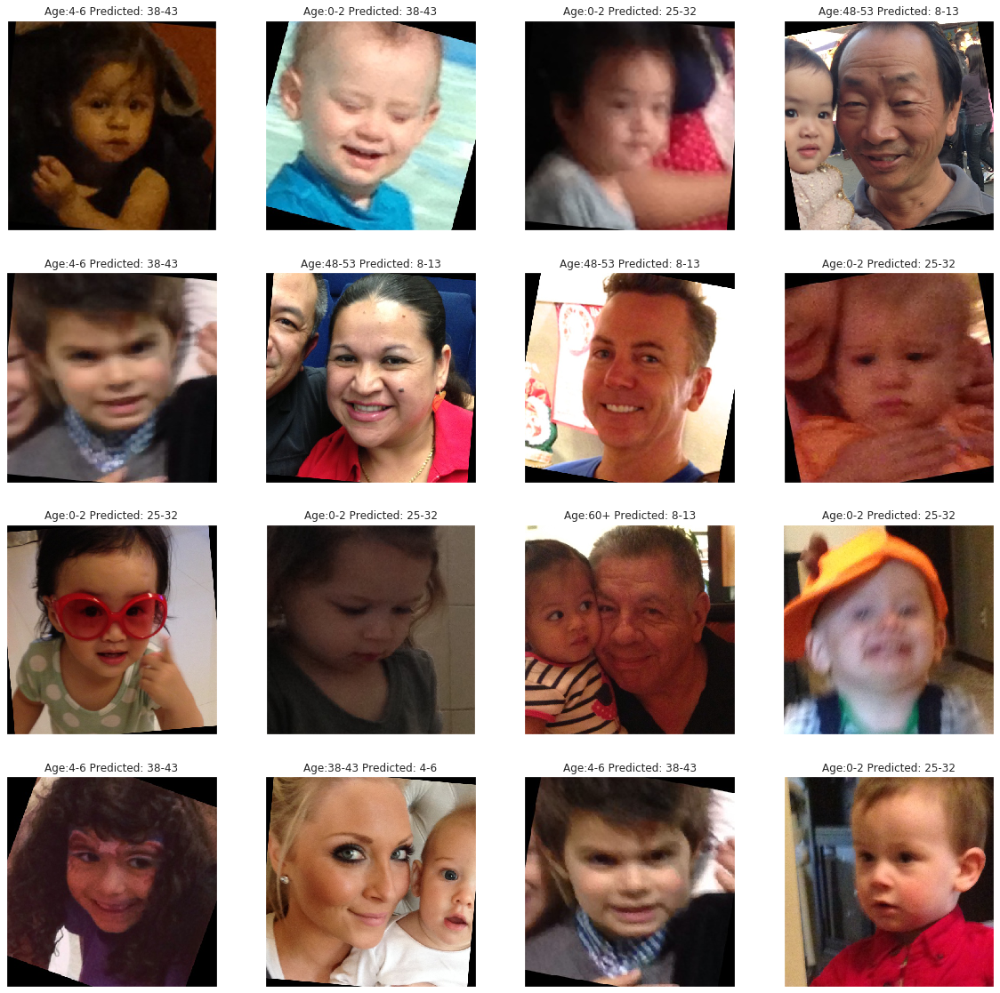

In [25]:
# Let us see the images that failed us from the Adience dataset 

# Many of these are misclassified due to having more than one photo in the page,
# wearing funny sunglasses, weird hats, or face painting.
# Also some of the photos are too blurry.
age_predictions = best_model.predict(adience_features)
adience_predictions_categories = list(map(lambda p: to_category(p[0]), age_predictions))
adience_data['predicted_cat'] = pd.Series(adience_predictions_categories)
show_sample_adience_images(adience_data[abs(adience_data['predicted_cat'] - adience_data['age_cat']) > 3], show_pred=True, save_file_name='figures/Misclassified_Adience.png')

In [26]:
def accuracy_within(test_data, x, save_file_name=None):
    within_x = test_data[abs(test_data['Age'] - test_data['predicted_age']) <= x]
    over_x = test_data[abs(test_data['Age'] - test_data['predicted_age']) > x]

    bins = np.linspace(0, 116, 100)
    fig, ax = plt.subplots(figsize=(15,5))
    plt.hist(within_x['Age'], bins, alpha=0.5, label='Accurate within {} years'.format(x))
    plt.hist(over_x['Age'], bins, alpha=0.5, label='Over {} year difference'.format(x))
    plt.legend(loc='upper right')
    plt.title('Frequency of Accurate estimation to {} Years Across Ages'.format(x))
    plt.xlabel('Age')
    plt.ylabel('Frequency')
    if save_file_name:
        plt.savefig(save_file_name)
    plt.show()

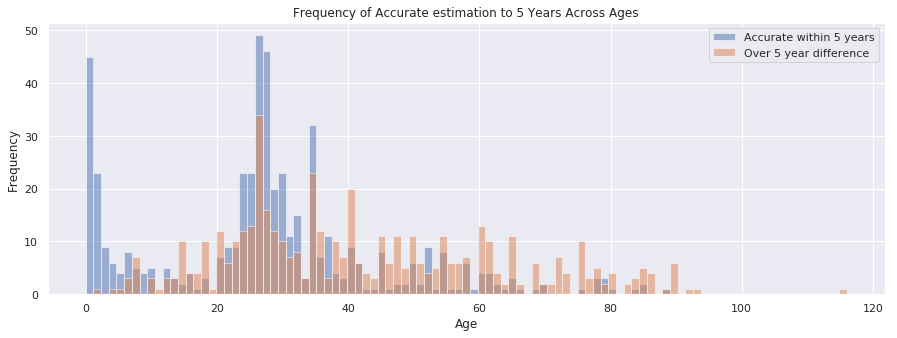

In [27]:
accuracy_within(updated_test_data, 5, 'figures/accuracy_within_5_years.png')

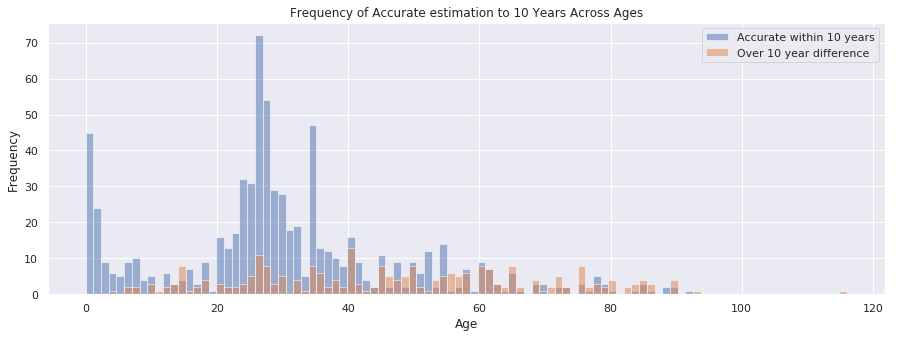

In [28]:
accuracy_within(updated_test_data, 10, 'figures/accuracy_within_10_years.png')

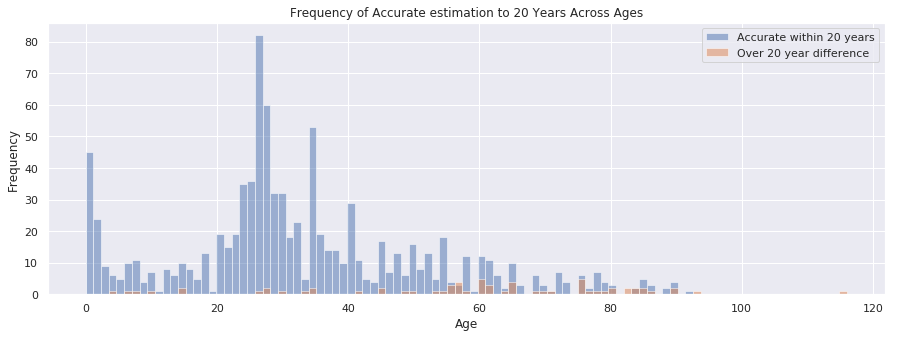

In [29]:
accuracy_within(updated_test_data, 20, 'figures/accuracy_within_20_years.png')

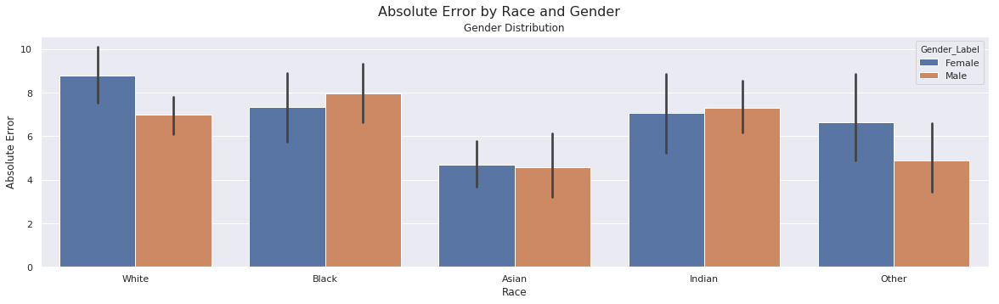

In [31]:
def show_absolute_error_by_race_and_gender(test_data, save_file_name=None):
    # the chart looks better with proper names
    def add_label_data_for_chart(data):
        def convert_race(r):
            if r == 0:
                return 'White'
            if r == 1:
                return 'Black'
            if r == 2:
                return 'Asian'
            if r == 3:
                return 'Indian'
            if r == 4:
                return 'Other'
        data['Gender_Label'] = data['Gender'].apply(lambda g: 'Male' if g == 0 else 'Female')
        data['Race_Label'] = data['Race'].apply(lambda r: convert_race(r))
        return data
    # we don't want to modify the actual dataset
    test_data = test_data.copy()
    test_data['error'] = abs(test_data['Age'] - test_data['predicted_age'])
    # add descriptive labels
    add_label_data_for_chart(test_data)
    # let's draw
    figure,ax=plt.subplots(figsize=(20,5))
    figure.suptitle('Absolute Error by Race and Gender', fontsize=16)
    sns.barplot(x='Race_Label', hue='Gender_Label', y='error',  data=test_data, ax=ax, order=['White', 'Black', 'Asian', 'Indian', 'Other']);
    ax.set_title('Gender Distribution')
    ax.set_xlabel('Race')
    ax.set_ylabel('Absolute Error')
    if save_file_name:
        plt.savefig(save_file_name)
    plt.close(2)
    
show_absolute_error_by_race_and_gender(updated_test_data, save_file_name='figures/absolute_error_by_race_and_gender.png')